<div style="padding:20px;
            color:white;
            margin:10;
            font-size:200%;
            text-align:center;
            display:fill;
            border-radius:5px;
            background-color:#682F2F;
            overflow:hidden;
            font-weight:700">Airline Passenger Satisfaction</div>

<div style = 'border : 3px solid ; background-color:#D6B2B1;padding:10px'>
    
    
**Dataset From kaggle https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction**

In [49]:
## This code will set the cell width to 90%. 
from IPython.display import display, HTML
display(HTML("<style>.container { width: 90% !important; }</style>"))

## <b><span style='color:#682F2F'>Dataset Attributes : </span></b> 

* <code>Gender</code> - Gender of the passengers (Female, Male)
* <code>Customer Type</code> - The customer type (Loyal customer, disloyal customer)
* <code>Age</code> - The actual age of the passengers
* <code>Type of Travel</code> - Purpose of the flight of the passengers (Personal Travel, Business Travel)
* <code>Class</code> - Travel class in the plane of the passengers (Business, Eco, Eco Plus)
* <code>Flight distance</code> - The flight distance of this journey
* <code>Inflight wifi service</code> - Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)
* <code>Departure/Arrival time convenient</code> - Satisfaction level of Departure/Arrival time convenient
* <code>Ease of Online booking</code> - Satisfaction level of online booking
* <code>Gate location</code> - Satisfaction level of Gate location
* <code>Food and drink</code> - Satisfaction level of Food and drink
* <code>Online boarding</code> - Satisfaction level of online boarding
* <code>Seat comfort</code> - Satisfaction level of Seat comfort
* <code>Inflight entertainment</code> - Satisfaction level of inflight entertainment
* <code>On-board service</code> - Satisfaction level of On-board service
* <code>Leg room service</code> - Satisfaction level of Leg room service
* <code>Baggage handling</code> - Satisfaction level of baggage handling
* <code>Check-in service</code> - Satisfaction level of Check-in service
* <code>Inflight service</code> - Satisfaction level of inflight service
* <code>Cleanliness</code> - Satisfaction level of Cleanliness
* <code>Departure Delay in Minutes</code> - Minutes delayed when departure
* <code>Arrival Delay in Minutes</code> - Minutes delayed when Arrival
* <code>Satisfaction</code> - Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

## 1. Importing Required libraries

In [50]:
## Import necessary libraries
import numpy as np
import pandas as pd

## Import missingno for visualizing missing data
import missingno as mo

## Import matplotlib for basic plotting
import matplotlib.pyplot as plt
from matplotlib import colors

## Import seaborn for statistical data visualization
import seaborn as sns

## Import plotly for interactive visualizations
import plotly.express as px
import plotly.io as pio

## Import os module for interacting with the operating system
import os

## OverSampling
from imblearn.over_sampling import SMOTE

## sklearn (preprocessing)
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer, OrdinalEncoder ##,RobustScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn_features.transformers import DataFrameSelector
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.ensemble import VotingClassifier

## sklearn (feature selection)
from sklearn.feature_selection import SelectKBest, f_classif ##, chi2

## sklearn (models)
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

## Import the XGBoost classifier
from xgboost import XGBClassifier

## sklearn (metrics)
from sklearn.metrics import f1_score, accuracy_score, make_scorer, confusion_matrix, classification_report, precision_score, recall_score

## sklearn (tuning)
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

## for dump the model
import joblib

## settings
## Import necessary modules from Plotly for offline plotting
from plotly.offline import init_notebook_mode, iplot
## Initialize Plotly for offline plotting and connect to the notebook
init_notebook_mode(connected=True)
## Set Pandas to display all columns in DataFrame
pd.set_option('display.max_columns', None)
## Set the default template for Plotly visualizations
pio.templates.default = "ggplot2"
## Set seaborn settings for plot aesthetics
sns.set(rc={"figure.figsize" : [15,8]}, font_scale=1.2)
sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#FFF9ED"})
## Define a custom color palette for seaborn
palette = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"]
sns.set_palette(palette)
## Create a color map for matplotlib using the defined palette
color_map = colors.ListedColormap(palette)

-------------------------

## 2. Read the Dataset

In [51]:
## Define the path to the train.csv file
TRAIN_PATH = os.path.join(os.getcwd(), "train.csv")

## Read the train.csv file into a DataFrame, using "Unnamed: 0" column as the index
df_train = pd.read_csv(TRAIN_PATH, index_col="Unnamed: 0")

## Define the path to the test.csv file
TEST_PATH = os.path.join(os.getcwd(), "test.csv")

## Read the test.csv file into a DataFrame, using "Unnamed: 0" column as the index
df_test = pd.read_csv(TEST_PATH, index_col="Unnamed: 0")

## Concatenate the train and test DataFrames vertically to create a combined DataFrame
df = pd.concat([df_train, df_test], axis=0)

In [52]:
df.shape

(129880, 24)

**The data contains 129,880 rows and 24 columns.**

In [53]:
# Check if the total number of rows in the combined (df) is equal to the sum of rows in the train and test DataFrames
# If the sum of rows in df_test and df_train is equal to the number of rows in df, the condition will evaluate True

df.shape[0] == df_test.shape[0] + df_train.shape[0]

True

--------------------------------

## 3. Overview about the Data

In [54]:
df.head() ## show the 5th rows in the data

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [55]:
df.describe().T.style.background_gradient(cmap=color_map) ## Statistical info. about numerical columns..

,count,mean,std,min,25%,50%,75%,max
id,129880.000000,64940.500000,37493.270818,1.000000,32470.750000,64940.500000,97410.250000,129880.000000
Age,129880.000000,39.427957,15.119360,7.000000,27.000000,40.000000,51.000000,85.000000
Flight Distance,129880.000000,1190.316392,997.452477,31.000000,414.000000,844.000000,1744.000000,4983.000000
Inflight wifi service,129880.000000,2.728696,1.329340,0.000000,2.000000,3.000000,4.000000,5.000000
Departure/Arrival time convenient,129880.000000,3.057599,1.526741,0.000000,2.000000,3.000000,4.000000,5.000000
Ease of Online booking,129880.000000,2.756876,1.401740,0.000000,2.000000,3.000000,4.000000,5.000000
Gate location,129880.000000,2.976925,1.278520,0.000000,2.000000,3.000000,4.000000,5.000000
Food and drink,129880.000000,3.204774,1.329933,0.000000,2.000000,3.000000,4.000000,5.000000
Online boarding,129880.000000,3.252633,1.350719,0.000000,2.000000,3.000000,4.000000,5.000000
Seat comfort,129880.000000,3.441361,1.319289,0.000000,2.000000,4.000000,5.000000,5.000000


In [56]:
df.describe(include="object").T ## Statistical info. about Categorical columns..

,count,unique,top,freq
Gender,129880,2,Female,65899
Customer Type,129880,2,Loyal Customer,106100
Type of Travel,129880,2,Business travel,89693
Class,129880,3,Business,62160
satisfaction,129880,2,neutral or dissatisfied,73452


----------------------------------------

## 4. Exploratory Data Analysis (EDA) 
- **Exploratory Data Analysis (EDA) refers to the method of studying and exploring record sets to apprehend their predominant traits, discover patterns, locate outliers, and identify relationships between variables.**
- ***source : https://www.geeksforgeeks.org/what-is-exploratory-data-analysis/***

### 4.1 Check DataTypes , Nulls and Duplicated.

In [57]:
df.dtypes ## Check the dataTypes..

id                                     int64
Gender                                object
Customer Type                         object
Age                                    int64
Type of Travel                        object
Class                                 object
Flight Distance                        int64
Inflight wifi service                  int64
Departure/Arrival time convenient      int64
Ease of Online booking                 int64
Gate location                          int64
Food and drink                         int64
Online boarding                        int64
Seat comfort                           int64
Inflight entertainment                 int64
On-board service                       int64
Leg room service                       int64
Baggage handling                       int64
Checkin service                        int64
Inflight service                       int64
Cleanliness                            int64
Departure Delay in Minutes             int64
Arrival De

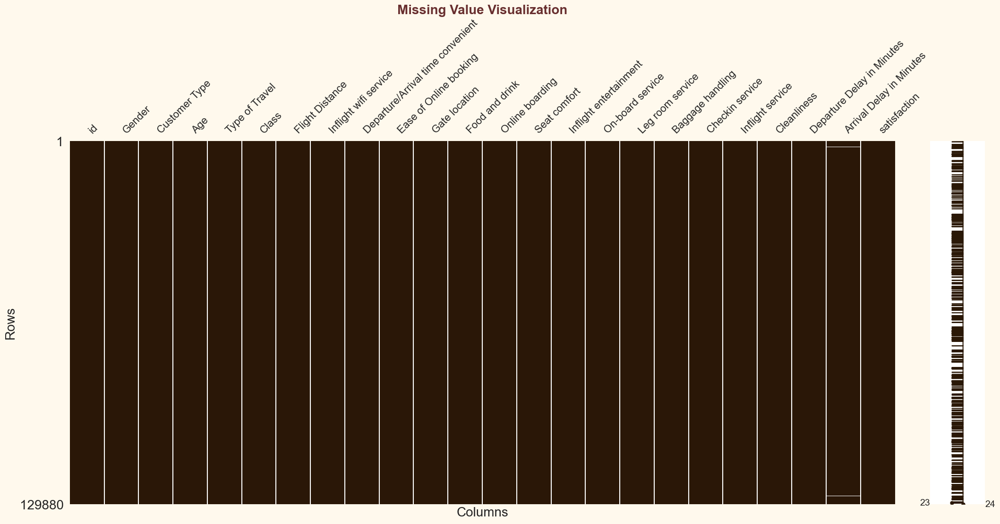

In [58]:
## Create the missing value matrix
mo.matrix(df, color=(42/255, 23.5/255, 7.1/255))

## title and axises
plt.title("Missing Value Visualization", fontsize=20, weight='bold', color="#682F2F")  ## title and adjust the font size and weight
plt.xlabel("Columns", fontsize=20)  ## x-axis label
plt.ylabel("Rows", fontsize=20)  ## y-axis label
# Show the plot
plt.show()

In [59]:
# Concatenate the count of null values and the percentage of null values into a single DataFrame
nullsFrame = pd.concat([df.isnull().sum(), round(df.isnull().mean() * 100,2)],
                       axis=1,
                       keys=["Count", "Ratio"])

## print the nullsFrame
print(f"The Data Frame of Missing Values in the Data : \n {nullsFrame}")

The Data Frame of Missing Values in the Data : 
                                    Count  Ratio
id                                     0    0.0
Gender                                 0    0.0
Customer Type                          0    0.0
Age                                    0    0.0
Type of Travel                         0    0.0
Class                                  0    0.0
Flight Distance                        0    0.0
Inflight wifi service                  0    0.0
Departure/Arrival time convenient      0    0.0
Ease of Online booking                 0    0.0
Gate location                          0    0.0
Food and drink                         0    0.0
Online boarding                        0    0.0
Seat comfort                           0    0.0
Inflight entertainment                 0    0.0
On-board service                       0    0.0
Leg room service                       0    0.0
Baggage handling                       0    0.0
Checkin service                        

> There is a missing value in `''Arrival Delay in Minutes''` column of about 0.3%. 

In [60]:
df.duplicated().any()

False

> There are no duplicate rows in the data

### 4.2 Drop Irrelvant Columns.

In [61]:
df["id"].nunique()

129880

In [62]:
df = df.drop(["id"], axis=1)

### 4.3 Univariate Analysis

#### `1. What is the Distribution of The "Gender" Feature?`

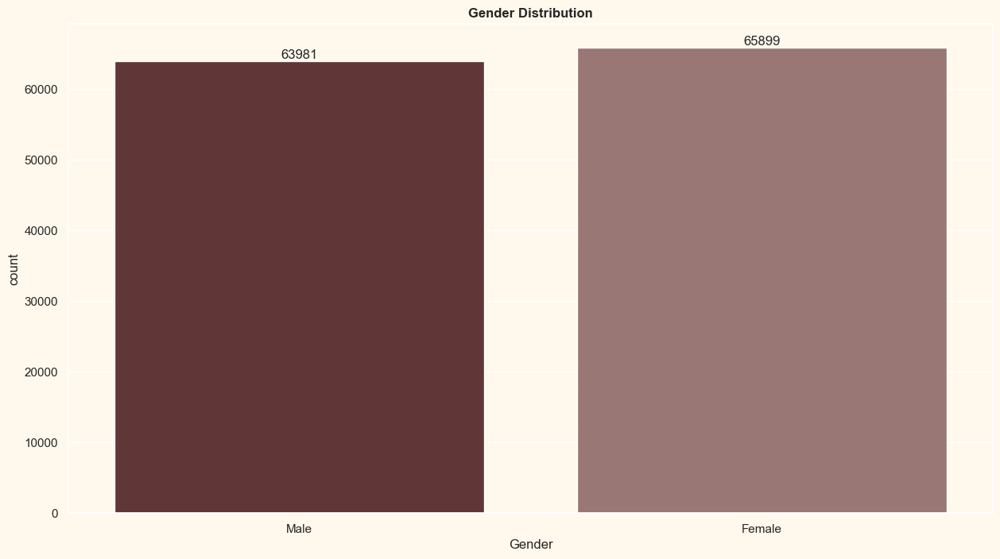

In [63]:
ax = sns.countplot(data=df, x="Gender")
for i in ax.containers:
    ax.bar_label(i)
plt.title("Gender Distribution", weight="bold")
plt.show()

<h4 style = "text-align:center; font-size:120%">The distribution of females and males is almost similar in the data.</h4>

#### `2. What are the different levels of satisfaction ("Satisfaction") reported by passengers?`

                         satisfaction
neutral or dissatisfied         73452
satisfied                       56428
****************************************************************************************************


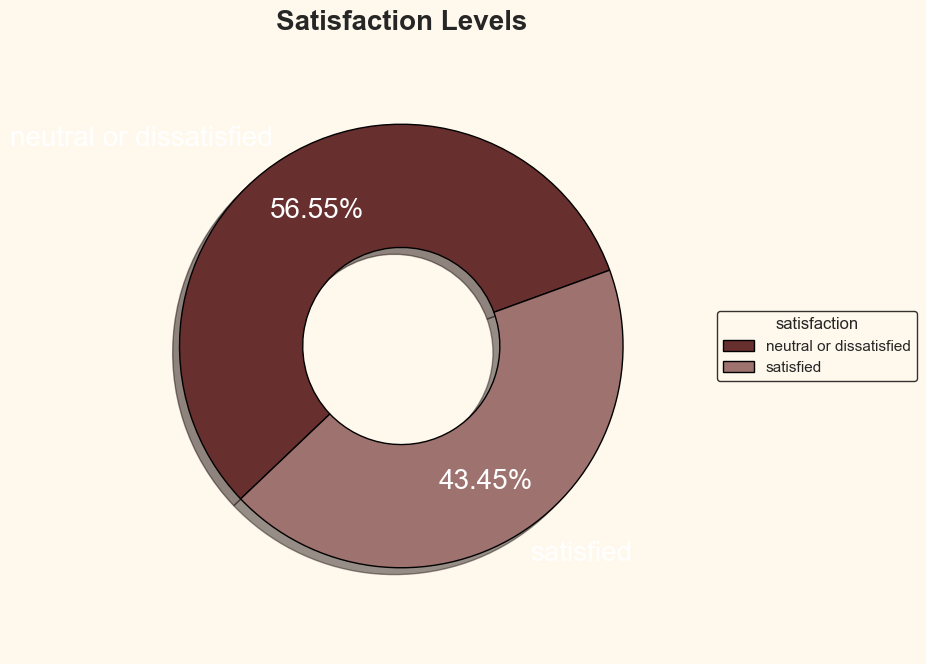

In [64]:
satisfaction_count = df["satisfaction"].value_counts()
print(satisfaction_count.to_frame())

print("**"*50)

labels = satisfaction_count.index
values = satisfaction_count.values

plt.pie(x=values, labels=labels,
        explode = (0,0),
        textprops=dict(size= 20, color= "white"),
        autopct="%.2f%%", 
        pctdistance = 0.72,
        radius=.9,
        shadow = True,
        wedgeprops=dict(width = 0.5, edgecolor = "black"),
        startangle = 20)
plt.legend(labels, title="satisfaction",loc="center left",bbox_to_anchor=(1, 0, 0.5, 1), edgecolor = "black")
plt.title("satisfaction levels".title(), fontsize=20, weight="bold")
plt.show()

<h4 style = "text-align:center; font-size:120%">55% of the passengers are neutral or dissatisfied. (imbalanced class)</h4>

#### `3. What is the distribution of the "Flight Distance" variable? Are there any outliers?`

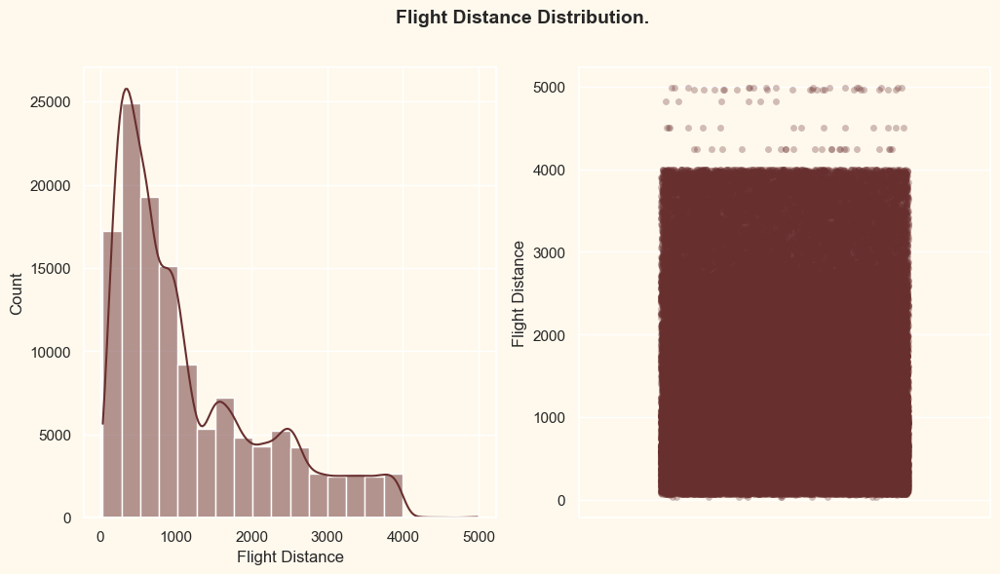

In [65]:
plt.figure(figsize = (12,6)) ## Set the figure size

## First subplot - Histogram with KDE
plt.subplot(1, 2, 1)
sns.histplot(data=df, x="Flight Distance", kde=True, bins=20)

## Second subplot - Strip plot
plt.subplot(1, 2, 2)
sns.stripplot(data=df, y="Flight Distance", jitter=0.3, alpha=0.3)
plt.suptitle("Flight Distance Distribution.", weight="bold", fontsize=14)
plt.show()

<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<ul>
<li> Right-Skewed Distribution (positively skewed).
<li> The flight distance contains outliers values.
</ul>
</div>

In [66]:
df["Flight Distance log"] = np.log1p(df["Flight Distance"])

##### `Why Log1p?`
- **log curve scales values near zeros linearly , and squashes high values.**
- **log(0)=inf, so we add 1.**

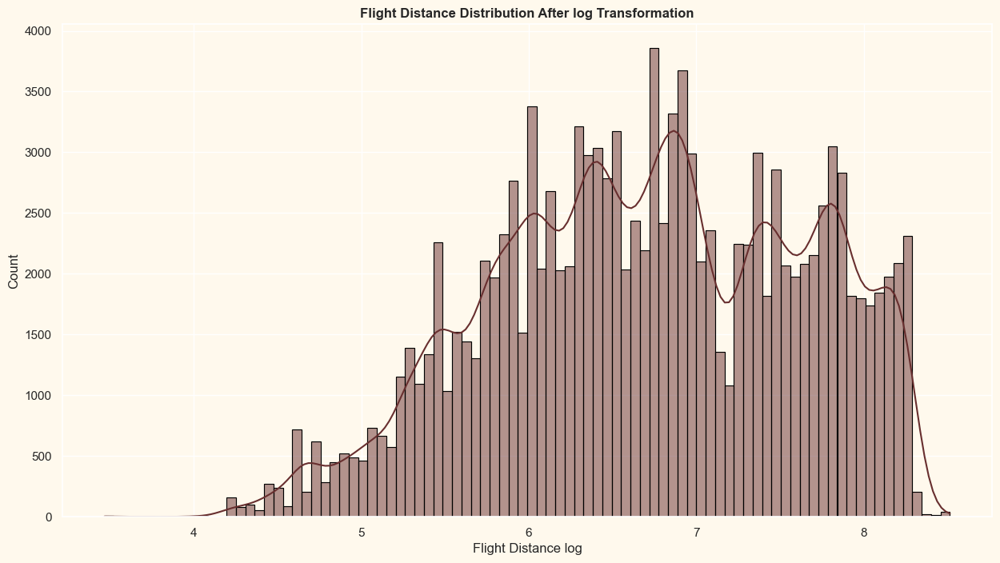

In [67]:
sns.histplot(df, x="Flight Distance log", kde=True, edgecolor="black")
plt.title("Flight Distance Distribution After log Transformation", weight="bold")
plt.show()

#### `4. How many passengers belong to each "Customer Type" category?`

In [68]:
## create a DataFrame with two columns: "Count" and "Ration."
pd.concat([df["Customer Type"].value_counts(), df["Customer Type"].value_counts(normalize=True)],
          axis=1, keys=["Count", "Ration"]) 

,Count,Ration
Loyal Customer,106100,0.816908
disloyal Customer,23780,0.183092


<h4 style = "text-align:center; font-size:120%">81% of the passengers are Loyal Customers.</h4>

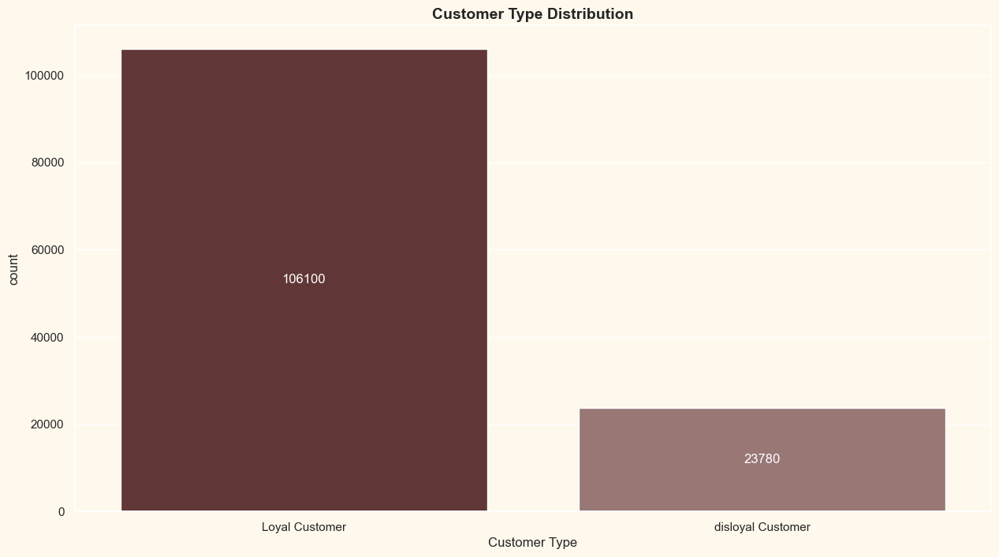

In [69]:
## create countplot
ax = sns.countplot(data=df, x="Customer Type")

## Add labels to the bars
for container in ax.containers:
    ax.bar_label(container, label_type="center", color="white")

## title
ax.set_title("Customer Type Distribution", fontsize=14, fontweight="bold")

## Show 
plt.show()

#### `5. What is the distribution of "Arrival or Departure Delay in Minutes"? Are there any extreme delays?`

In [70]:
arrival_dept_depaly = ["Arrival Delay in Minutes", "Departure Delay in Minutes"]
df[arrival_dept_depaly].describe().style.background_gradient(cmap=color_map)

,Arrival Delay in Minutes,Departure Delay in Minutes
count,129487.000000,129880.000000
mean,15.091129,14.713713
std,38.465650,38.071126
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,13.000000,12.000000
max,1584.000000,1592.000000


<h4 style = "text-align:center; font-size:120%">It is very clear that there are outliers.</h4>

***Let's draw a box plot with Seaborn to be sure.***

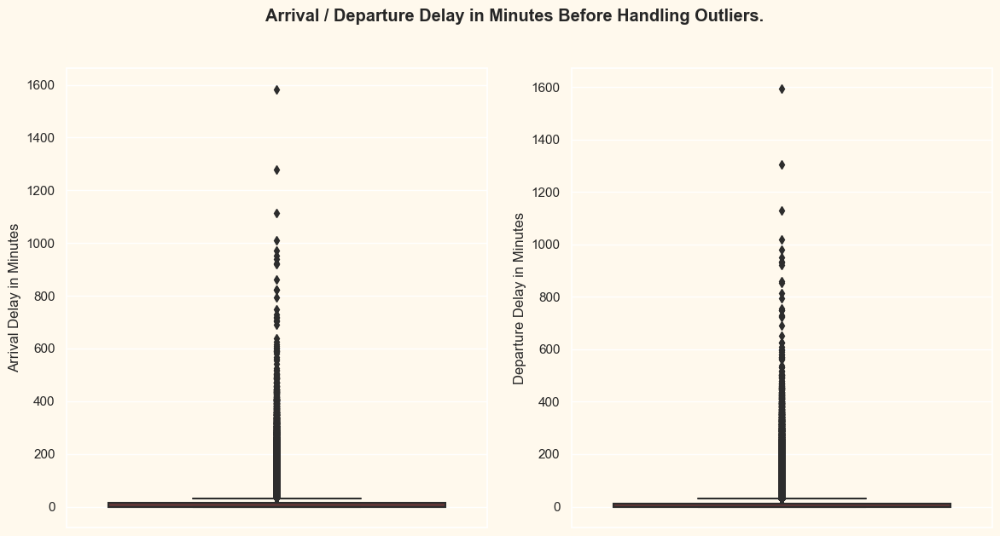

In [71]:
plt.figure(figsize = (14,7))

plt.suptitle("Arrival / Departure Delay in Minutes Before Handling Outliers.", weight="bold")
for i, col in enumerate(arrival_dept_depaly):
    plt.subplot(1, 2, i+1)
    sns.boxplot(data=df, y=col)

plt.show()

In [72]:
### Handling ouliers of arrival/dept. delay >> replace outliers with mean value for each column

print(f"the number of the passengers arrival delay > 400 before handling outliers -- {len(df.loc[(df['Arrival Delay in Minutes'] > 400)])}".title())
print(f"the number of the passengers Departure delay > 400 before handling outliers -- {len(df.loc[(df['Departure Delay in Minutes'] > 400)])}".title())
print("**"*50)

mean_arrival = df["Arrival Delay in Minutes"].mean()
df.loc[(df["Arrival Delay in Minutes"] > 400), "Arrival Delay in Minutes"] = mean_arrival

mean_dept = df["Departure Delay in Minutes"].mean()
df.loc[(df["Departure Delay in Minutes"] > 400), "Departure Delay in Minutes"] = mean_dept

print("After Handling 2 Columns with replace outliers by mean")
print("**"*50)
print(f"the number of the passengers arrival delay > 400 -- {len(df.loc[(df['Arrival Delay in Minutes'] > 400)])}".title())
print(f"the number of the passengers Departure delay > 400 -- {len(df.loc[(df['Departure Delay in Minutes'] > 400)])}".title())

The Number Of The Passengers Arrival Delay > 400 Before Handling Outliers -- 113
The Number Of The Passengers Departure Delay > 400 Before Handling Outliers -- 102
****************************************************************************************************
After Handling 2 Columns with replace outliers by mean
****************************************************************************************************
The Number Of The Passengers Arrival Delay > 400 -- 0
The Number Of The Passengers Departure Delay > 400 -- 0


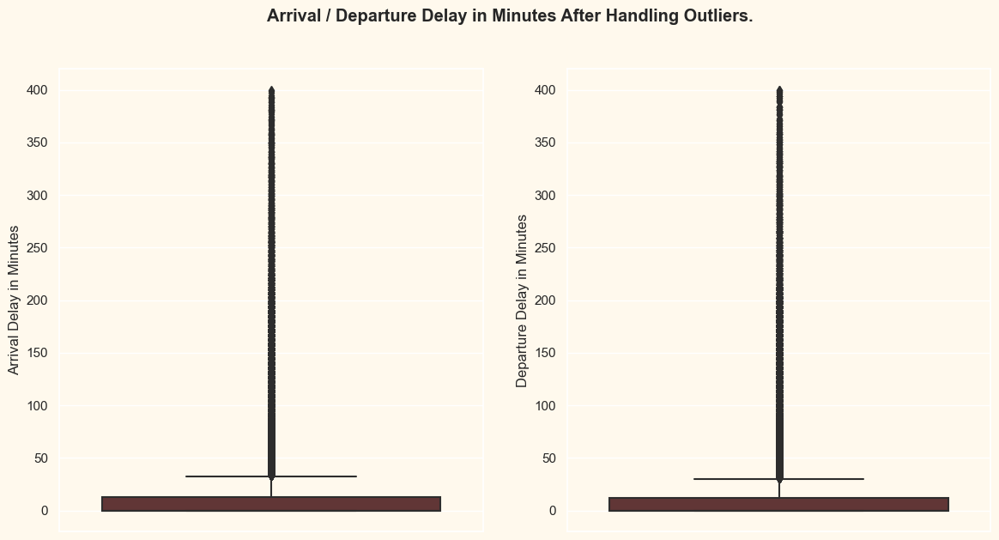

In [73]:
plt.figure(figsize = (14,7))

plt.suptitle("Arrival / Departure Delay in Minutes After Handling Outliers.", weight="bold")
for i, col in enumerate(arrival_dept_depaly):
    plt.subplot(1, 2, i+1)
    sns.boxplot(data=df, y=col)

plt.show()

#### `6. What is the distribution of "Inflight Wi-Fi Service" ratings provided by passengers?`

In [74]:
df["Inflight wifi service"].value_counts(normalize=True)*100

2    24.884509
3    24.780567
4    19.075300
1    17.191253
5    11.053280
0     3.015091
Name: Inflight wifi service, dtype: float64

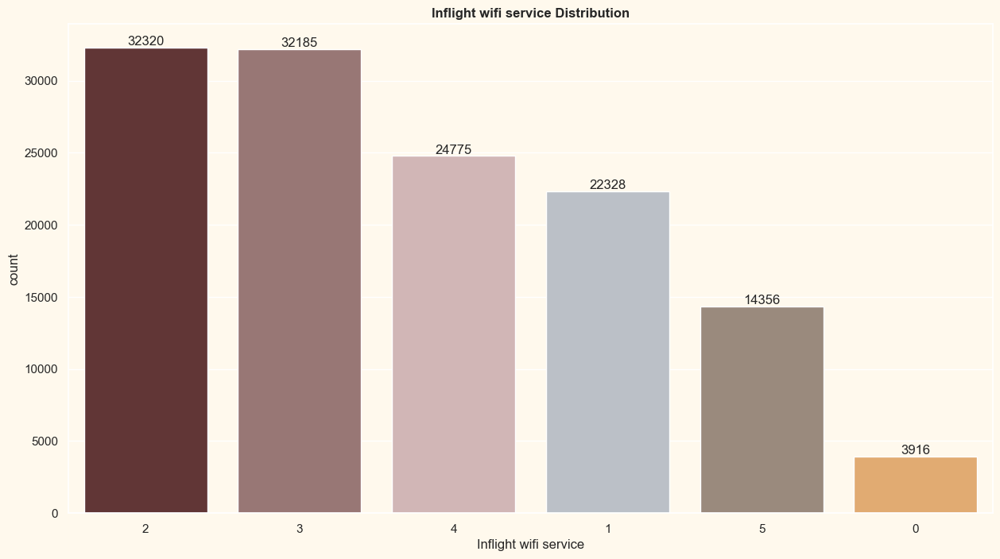

In [75]:
ax = sns.countplot(data=df, x="Inflight wifi service",
              order=df["Inflight wifi service"].value_counts(normalize=True).index)
for i in ax.containers:
    ax.bar_label(i)
plt.title("Inflight wifi service Distribution", weight="bold")
plt.show()

<h4 style = "text-align:center; font-size:120%">Wi-Fi on board seems good.</h4>

#### `7. How does the "Seat Comfort" Feature vary across the dataset?`

In [76]:
df["Seat comfort"].unique()

array([5, 1, 2, 3, 4, 0], dtype=int64)

In [77]:
df["Seat comfort"].value_counts()

4    39756
5    33158
3    23328
2    18529
1    15108
0        1
Name: Seat comfort, dtype: int64

<h4 style = "text-align:center; font-size:120%">The majority of passengers voted that the seats were comfortable.</h4>

#### `8. What is the distribution of "Departure/Arrival Time Convenient" ratings?`

In [78]:
df["Departure/Arrival time convenient"].value_counts()

4    31880
5    27998
3    22378
2    21534
1    19409
0     6681
Name: Departure/Arrival time convenient, dtype: int64

In [79]:
df["Departure/Arrival time convenient"].median()

3.0

<h4 style = "text-align:center; font-size:120%">The majority of travelers expressed their opinion that the arrival and departure time was appropriate.</h4>

#### `9. What are the different "Class" options available to passengers? How many passengers are in each class?`

In [80]:
df["Class"].unique()

array(['Eco Plus', 'Business', 'Eco'], dtype=object)

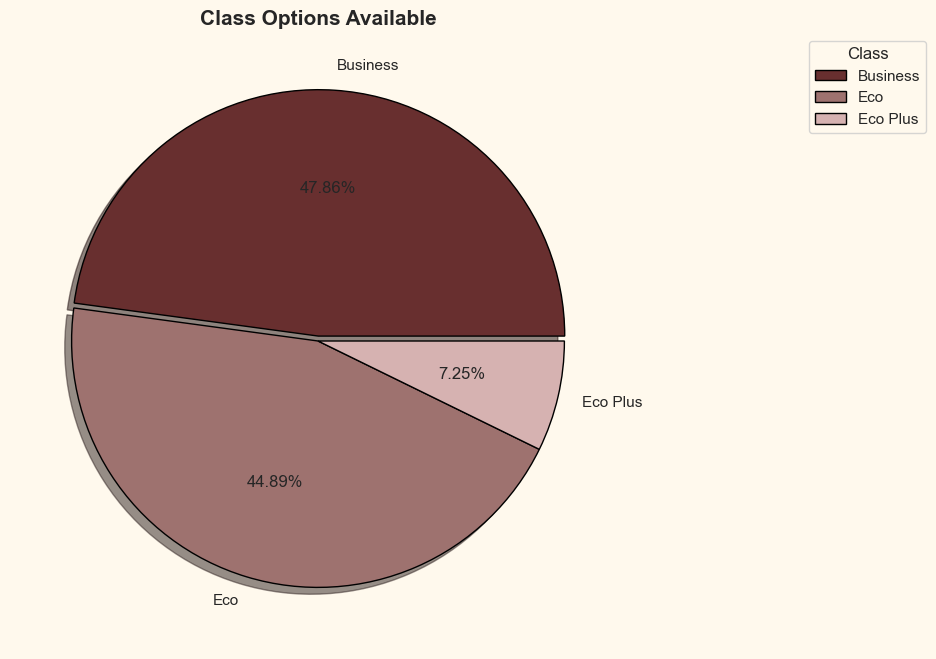

In [81]:
plt.pie(x=df["Class"].value_counts().values, labels=df["Class"].value_counts().index,
        autopct = '%1.2f%%',
        explode = (0.02,0,0),
        wedgeprops = {'edgecolor': 'black','linewidth': 1, 'antialiased' : True}, shadow=True)

plt.legend(title="Class",loc="best",bbox_to_anchor=(1, 0, 0.5, 1))
plt.title("Class options available".title(), fontsize=15, weight="bold")
plt.show()

<h4 style = "text-align:center; font-size:120%">Most passengers choose Business and Economy class.</h4>

#### `10. How does the "Age" Feature vary across the dataset? Is there a specific age group that dominates?`

In [82]:
df["Age"].describe()

count    129880.000000
mean         39.427957
std          15.119360
min           7.000000
25%          27.000000
50%          40.000000
75%          51.000000
max          85.000000
Name: Age, dtype: float64

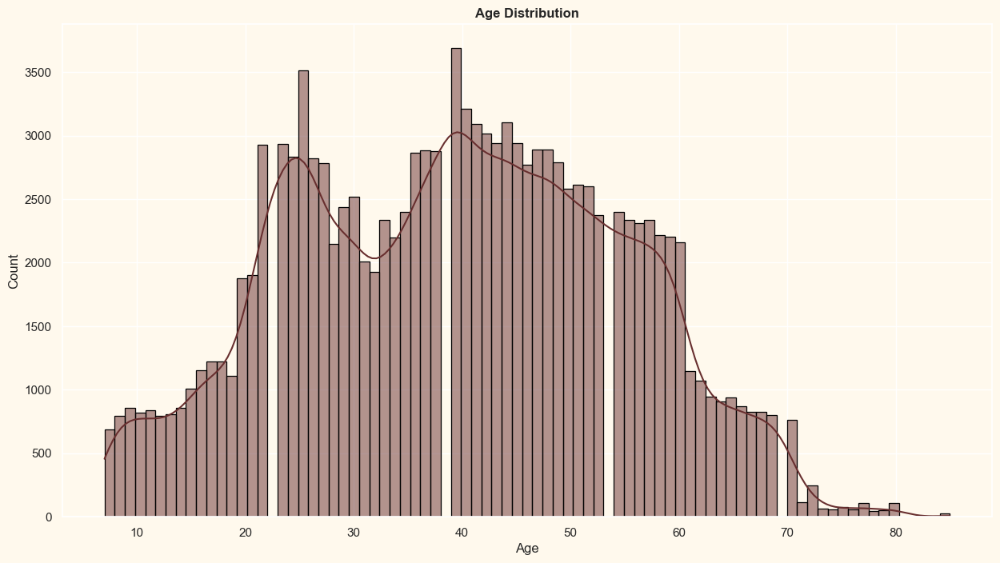

In [83]:
sns.histplot(df, x="Age", kde=True, edgecolor="black")
plt.title("Age Distribution", weight="bold")
plt.show()

<h4 style = "text-align:center; font-size:120%">Most passengers are between the ages of 20 and 60.
</h4>

#### `11. What is the Distribution of The "Type of Travel" Feature?`

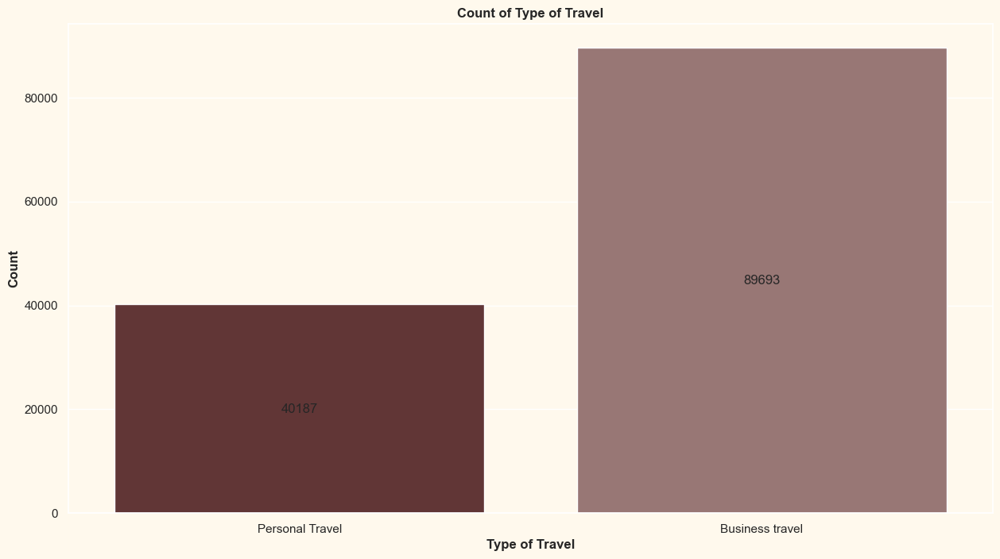

In [84]:
# Create the countplot
ax = sns.countplot(data=df, x="Type of Travel")

# Add count labels to the bars
for container in ax.containers:
    ax.bar_label(container, label_type='center')  # Add labels at the center of the bars

ax.set_xlabel("Type of Travel", weight="bold")  # Set x-axis label
ax.set_ylabel("Count", weight="bold")  # Set y-axis label
ax.set_title("Count of Type of Travel", weight="bold")  # Set plot title

plt.show()

In [85]:
df["Type of Travel"].value_counts(normalize=True) * 100

Business travel    69.058362
Personal Travel    30.941638
Name: Type of Travel, dtype: float64

<h4 style = "text-align:center; font-size:120%">business travel ( 69% ) is more common than personal travel ( 31% ).</h4>

#### `12. Check Services for passengers`
- **`On-board service`: Satisfaction level of On-board service**
- **`Leg room service`: Satisfaction level of Leg room service**
- **`Check-in service`: Satisfaction level of Check-in service**
- **`Inflight service`: Satisfaction level of inflight service**

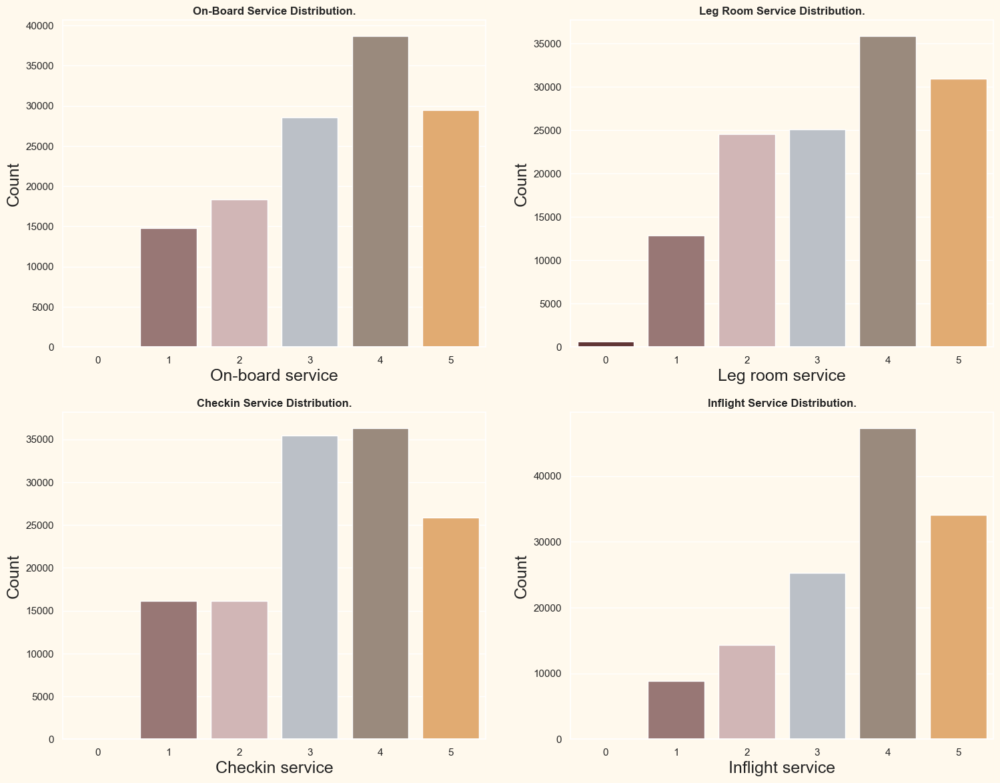

************************************************************************************************************************
On-board service Counts.
4    29.799045
5    22.707114
3    21.975670
2    14.129196
1    11.385125
0     0.003850
Name: On-board service, dtype: float64
************************************************************************************************************************
Leg room service Counts.
4    27.630120
5    23.795042
3    19.291654
2    18.894364
1     9.928395
0     0.460425
Name: Leg room service, dtype: float64
************************************************************************************************************************
Checkin service Counts.
4    27.974284
3    27.296735
5    19.928395
1    12.402217
2    12.397598
0     0.000770
Name: Checkin service, dtype: float64
************************************************************************************************************************
Inflight service Counts.
4    36.435941
5    26.228827
3

In [86]:
services = ["On-board service", "Leg room service", "Checkin service", "Inflight service"]

plt.figure(figsize = (18, 14))

for i, col in enumerate(services):
    plt.subplot(2, 2, i+1)
    sns.countplot(data=df, x=col)
    plt.title(f"{col} Distribution.".title(), weight="bold")
    plt.xlabel(col, fontsize=18)
    plt.ylabel("Count", fontsize=18)

plt.show()

print("**"*60)
for col in services:
    print(f"{col} Counts.")
    print(df[col].value_counts(normalize=True) * 100)
    print("**"*60)

#### `13. Satisfaction level of Cleanliness`

In [87]:
df["Cleanliness"].unique()

array([5, 1, 2, 3, 4, 0], dtype=int64)

In [88]:
df["Cleanliness"].value_counts()

4    33969
3    30639
5    28416
2    20113
1    16729
0       14
Name: Cleanliness, dtype: int64

In [89]:
print(f"Average passenger opinions about cleanliness -- {df['Cleanliness'].median()}")

Average passenger opinions about cleanliness -- 3.0


#### `14. Satisfaction level of Food and drink`

In [90]:
df["Food and drink"].nunique()

6

In [91]:
df["Food and drink"].value_counts(normalize=True)

4    0.235317
5    0.215253
3    0.213998
2    0.210833
1    0.123583
0    0.001016
Name: Food and drink, dtype: float64

#### `14. Satisfaction level of online booking & Satisfaction level of online boarding`

In [92]:
pd.concat([df["Online boarding"].value_counts(normalize=True), df["Ease of Online booking"].value_counts(normalize=True)],
          axis=1, keys=["boarding", "booking"]) 

,boarding,booking
4,0.296181,0.188204
3,0.208785,0.234008
5,0.200339,0.134155
2,0.168879,0.231375
1,0.102102,0.168509
0,0.023714,0.043748


#### `15. Satisfaction level of Gate location & inflight entertainment & baggage handling`

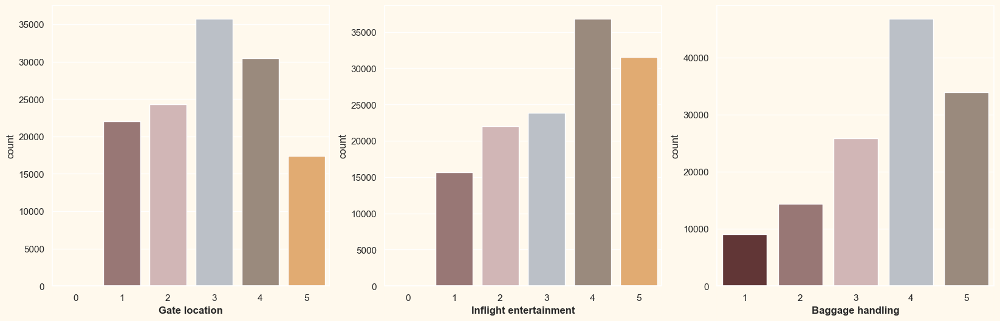

In [93]:
fea_pie = ["Gate location", "Inflight entertainment", "Baggage handling"]

## Gate location: Satisfaction level of Gate location
## Inflight entertainment: Satisfaction level of inflight entertainment
## Baggage handling: Satisfaction level of baggage handling

plt.figure(figsize=(20,6)) ## figure size

## loop 
for idx, feat in enumerate(fea_pie): 
    plt.subplot(1, 3, idx+1) 
    sns.countplot(data=df, x=feat)
    plt.xlabel(feat, weight='bold')

plt.show()    

### `Conclusion for Univariate Analysis Part`

<div class="alert alert-block alert-info" style="background-color:#682F2F;
                                                 color:white;
                                                 border-color:black;
                                                 border-radius:5px;
                                                 width:70%;
                                                 margin: auto;
                                                 text-align: left;">
<b>The satisfaction level with the services is relatively average, and efforts should be made to improve the quality of services in order to meet passenger expectations.
</div>

### 4.4 Bi-variate Analysis

#### Correlation Between all Numerical Features

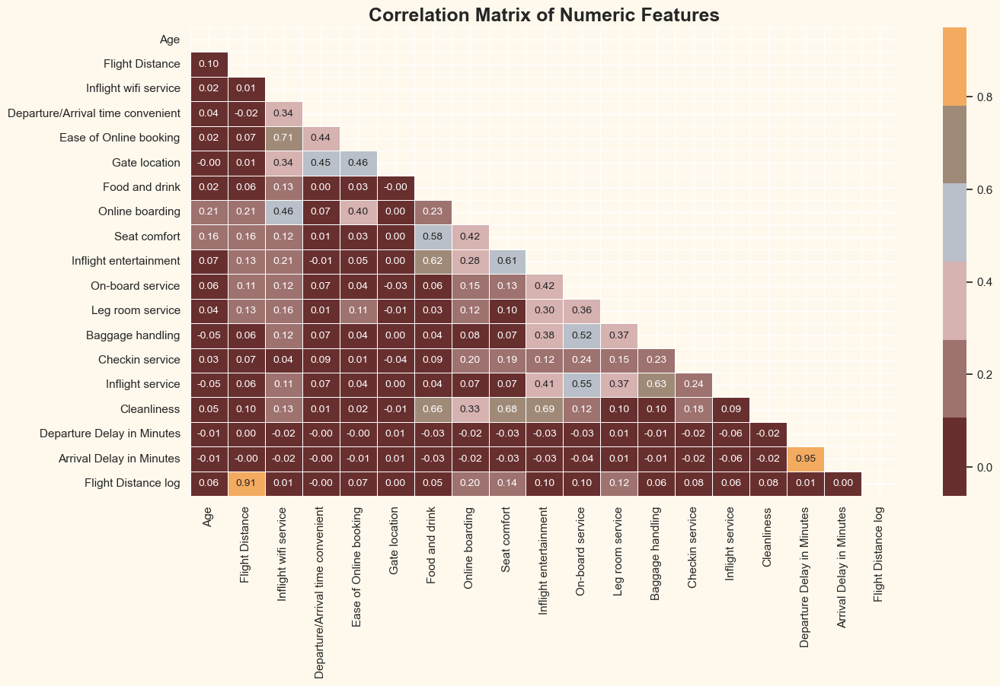

In [94]:
## correlation matrix
correlation_matrix = df.corr(numeric_only=True)

## mask
mask = np.triu(np.ones_like(df.corr(numeric_only=True)))


## heatmap
sns.heatmap(correlation_matrix, mask=mask, annot=True, cmap=color_map, fmt=".2f",
            annot_kws={'size': 10}, linewidths=0.5, cbar=True)

## title
plt.title("Correlation Matrix of Numeric Features", fontsize=18, weight="bold")

## Show the plot
plt.show()

<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<ul>
<li> There is a strong +ve correlation between Arrival Delay and Departure Delay.
<li> There is a strong +ve correlation between ease of online booking and inflight wifi service.
<li> There is a strong correlation between food and drink and Cleanliness.
<li> There is a strong correlation between Seat comfort and Cleanliness.
<li> There is a strong correlation between inflight entertainment and Cleanliness.
    
</ul>
</div>

#### `1. Is there a relationship between the type of travel (e.g., business, personal) and the satisfaction level of passengers?`

In [95]:
def countplot_bi(data, x, y):
    # Create the countplot with hue
    sns.countplot(data=data, x=x, hue=y)
    
    # Set the title of the plot
    plt.title(f"{x} Vs. {y}", fontsize=18, weight="bold")
    
    # Display the plot
    plt.show()

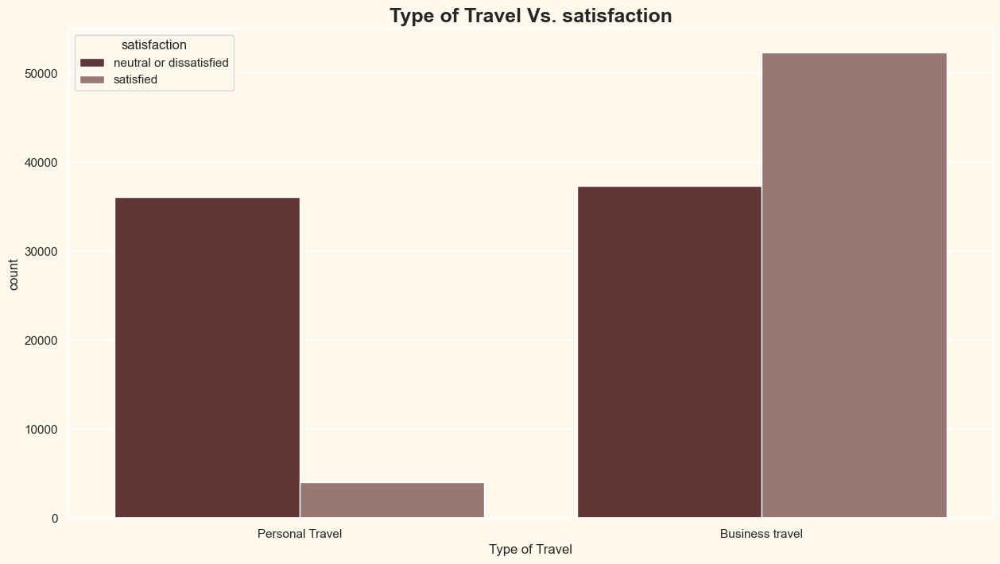

In [96]:
countplot_bi(data=df, x="Type of Travel", y="satisfaction")

In [97]:
df.groupby("Type of Travel")["satisfaction"].value_counts(normalize=True).to_frame() 

satisfaction
Type of Travel  satisfaction                         
Business travel satisfied                    0.583724
                neutral or dissatisfied      0.416276
Personal Travel neutral or dissatisfied      0.898674
                satisfied                    0.101326

- **In Personal Travel, passengers who are neutral or dissatisfied far outnumber the satisfied ones.**
- **In business travel, the proportion of satisfied passengers is  higher at 58%.**
> ***Overall, there is an issue that needs to be addressed, whether in Personal Travel or Business Travel.***

#### `2. Is there a correlation between the flight distance and arrival delay?`

In [98]:
df[['Flight Distance', 'Arrival Delay in Minutes']].corr()

,Flight Distance,Arrival Delay in Minutes
Flight Distance,1.000000,-0.004081
Arrival Delay in Minutes,-0.004081,1.000000


In [99]:
fig = px.scatter(
    df,
    x="Flight Distance",
    y="Arrival Delay in Minutes",
    marginal_x="histogram",
    marginal_y="histogram",
    title="<b>Correlation between Flight Distance and Arrival Delay",
    color_discrete_sequence=px.colors.qualitative.Antique
)

# Show the plot
fig.show()

<h4 style = "text-align:center; font-size:120%">There is no relationship between flight distance and arrival delay.</h4>

#### `3. Does the satisfaction level of passengers vary based on the inflight entertainment rating?`

In [100]:
df.groupby("Inflight entertainment")["satisfaction"].value_counts(normalize=True).to_frame()

satisfaction
Inflight entertainment satisfaction                         
0                      neutral or dissatisfied      1.000000
1                      neutral or dissatisfied      0.858054
                       satisfied                    0.141946
2                      neutral or dissatisfied      0.787327
                       satisfied                    0.212673
3                      neutral or dissatisfied      0.726846
                       satisfied                    0.273154
4                      satisfied                    0.611128
                       neutral or dissatisfied      0.388872
5                      satisfied                    0.650615
                       neutral or dissatisfied      0.349385

<h4 style = "text-align:center; font-size:120%">Considering a ['4' , '5']-star rating, the level of entertainment on the airplane is related to passenger satisfaction.</h4>

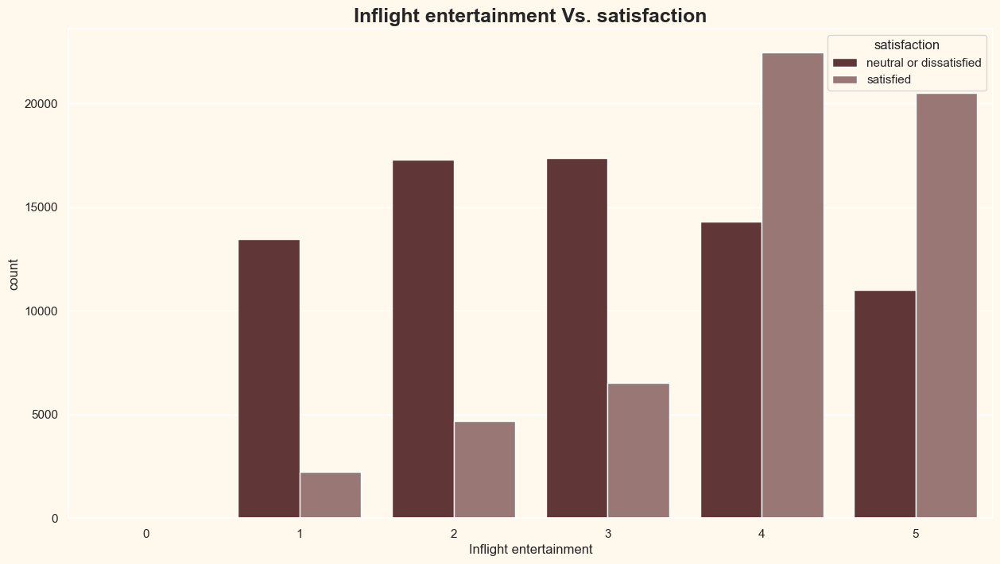

In [101]:
countplot_bi(data=df, x="Inflight entertainment", y="satisfaction")

#### `4. Is there an association between the cleanliness rating of airlines and the overall satisfaction of passengers?`

In [102]:
df.groupby("Cleanliness")["satisfaction"].value_counts().to_frame()

satisfaction
Cleanliness satisfaction                         
0           neutral or dissatisfied            14
1           neutral or dissatisfied         13434
            satisfied                        3295
2           neutral or dissatisfied         15836
            satisfied                        4277
3           neutral or dissatisfied         17370
            satisfied                       13269
4           satisfied                       18183
            neutral or dissatisfied         15786
5           satisfied                       17404
            neutral or dissatisfied         11012

In [103]:
df.groupby("Cleanliness")["satisfaction"].value_counts(normalize=True).to_frame()

satisfaction
Cleanliness satisfaction                         
0           neutral or dissatisfied      1.000000
1           neutral or dissatisfied      0.803037
            satisfied                    0.196963
2           neutral or dissatisfied      0.787351
            satisfied                    0.212649
3           neutral or dissatisfied      0.566925
            satisfied                    0.433075
4           satisfied                    0.535282
            neutral or dissatisfied      0.464718
5           satisfied                    0.612472
            neutral or dissatisfied      0.387528

<h4 style = "text-align:center; font-size:120%">There is a weak Correlation between cleanliness and overall passenger satisfaction.</h4>

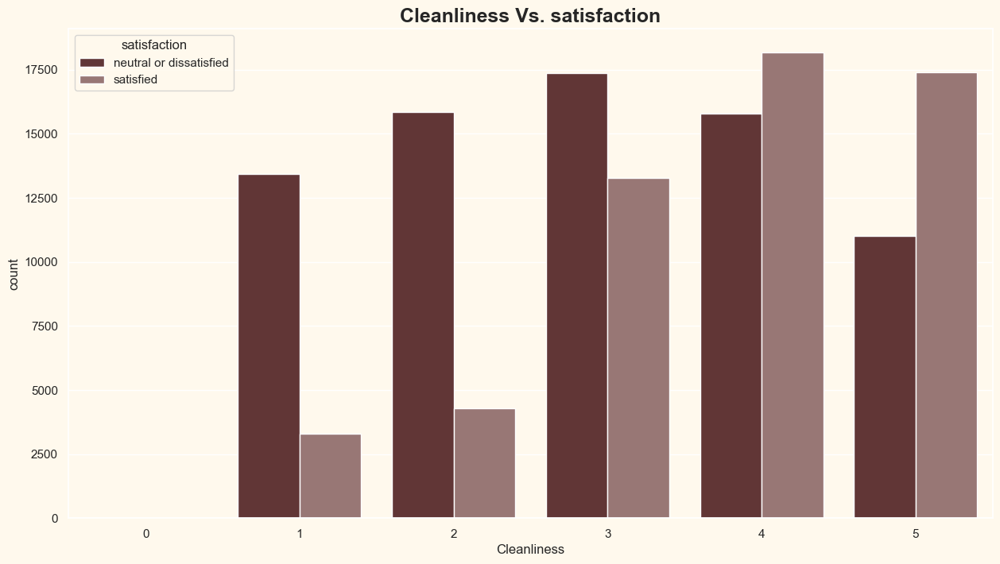

In [104]:
countplot_bi(data=df, x="Cleanliness", y="satisfaction")

####  `5. Are there any differences in the satisfaction ratings between male and female passengers?`

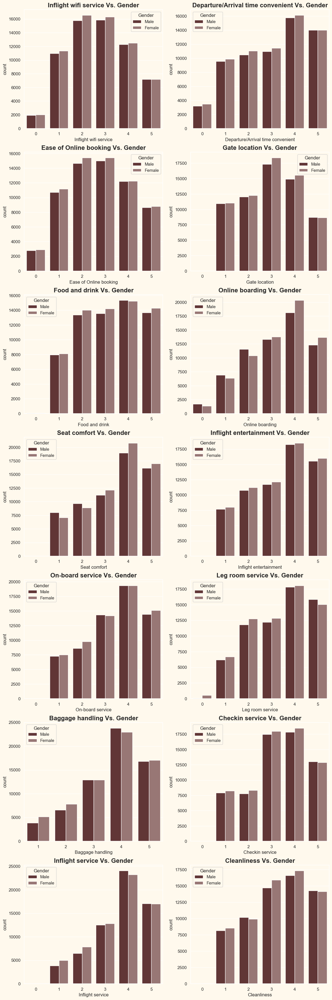

In [105]:
satisfaction_ratings = ['Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']

## len(satisfaction_ratings) == > 14 

plt.figure(figsize=(14,45))
for idex, col in enumerate(satisfaction_ratings):
    plt.subplot(7, 2, idex+1) ## len=14 ----------- 2*7=14 -_-
    sns.countplot(data=df, x=col, hue="Gender")
    plt.title(f"{col} Vs. Gender", fontsize=16, weight="bold")
plt.show()

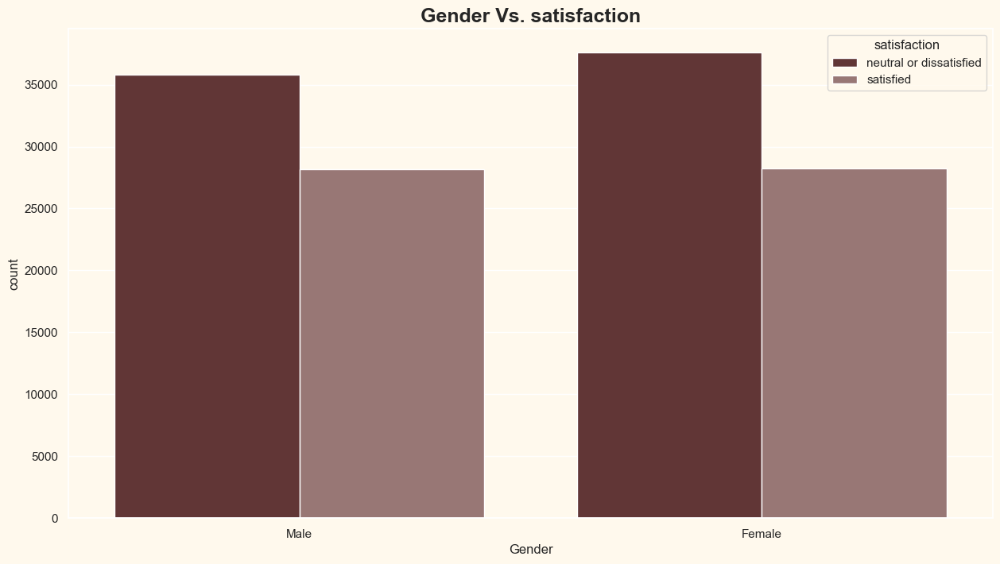

In [106]:
countplot_bi(data=df, x="Gender", y="satisfaction")

#### `6. Does the departure delay have an impact on the passengers' rating of the overall flight experience?`

In [107]:
fig = px.box(data_frame=df,
            y="Departure Delay in Minutes",
            color="satisfaction",
            color_discrete_sequence=px.colors.qualitative.Antique,
            title="<b>Departure Delay by satisfaction")
fig.show()

#### `7. Do passengers' satisfaction levels differ based on the Class?`

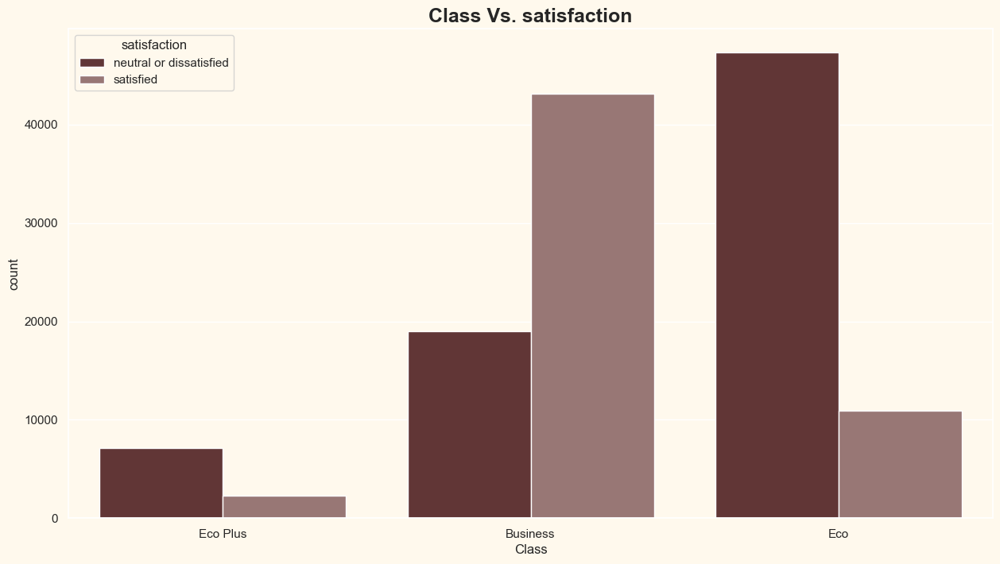

In [108]:
countplot_bi(data=df, x="Class", y="satisfaction")

<h4 style = "text-align:center; font-size:120%">A large proportion of Business passengers have a high satisfaction level.</h4>

In [109]:
df.groupby("Class")["satisfaction"].value_counts(normalize=True).to_frame()

satisfaction
Class    satisfaction                         
Business satisfied                    0.694434
         neutral or dissatisfied      0.305566
Eco      neutral or dissatisfied      0.812327
         satisfied                    0.187673
Eco Plus neutral or dissatisfied      0.753586
         satisfied                    0.246414

#### `8. Is there a correlation between the age of passengers and their satisfaction ratings?` 

In [110]:
# Create the histogram
fig = px.histogram(data_frame=df, x="Age", color="satisfaction",
                   color_discrete_sequence=px.colors.qualitative.Antique)

# Customize the plot
fig.update_layout(
    title="<b>Age Distribution by Satisfaction</b>",
    barmode="overlay"
)
fig.update_traces(opacity=0.7)  # Adjust the opacity of the bars

# Show the plot
fig.show()

In [111]:
df.groupby("satisfaction")["Age"].mean().to_frame()

,Age
satisfaction,
neutral or dissatisfied,37.650997
satisfied,41.741015


#### `9. Arrival Delay Vs. Departure Delay.` 

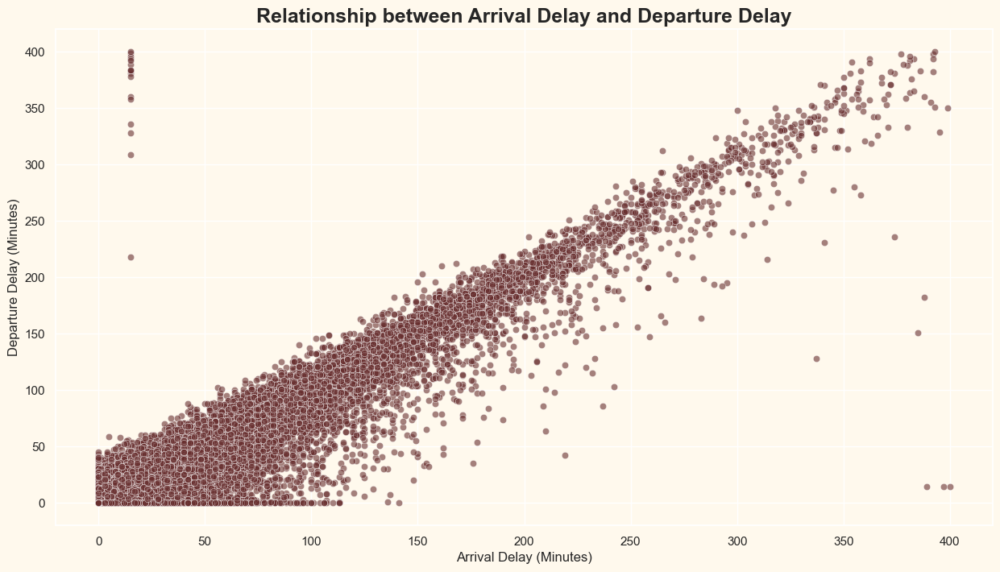

In [112]:
## scatter plot using seaborn
sns.scatterplot(data=df, x="Arrival Delay in Minutes", y="Departure Delay in Minutes", alpha=0.6)

## labels and title
plt.title("Relationship between Arrival Delay and Departure Delay", fontsize=18, weight="bold")
plt.xlabel("Arrival Delay (Minutes)")
plt.ylabel("Departure Delay (Minutes)")

## Show the plot
plt.show()

<h4 style = "text-align:center; font-size:120%">The correlation between Arrival Delay and Departure Delay is very strong.</h4>

#### `10. Age Vs. Class`

In [113]:
## box plot using plotly (age, class)
fig = px.box(data_frame=df, x="Age", color="Class", color_discrete_sequence=px.colors.qualitative.Antique)

fig.update_layout(
    title="<b>Age Dist. by Class."
)

## show plot 
fig.show()

<h4 style = "text-align:center; font-size:120%">There are outliers values in the business category.</h4>

#### `11. Flight Distance Vs. Type of Travel`

In [114]:
## violin plot using plotly
fig = px.violin(data_frame=df, y="Flight Distance", color="Type of Travel", #box=True, 
                color_discrete_sequence=px.colors.qualitative.Antique,
                title="<b>Flight Distance Dist. by Type of Travel")

## show plot 
fig.show()

#### `12. Customer Type Vs. Satisfaction`

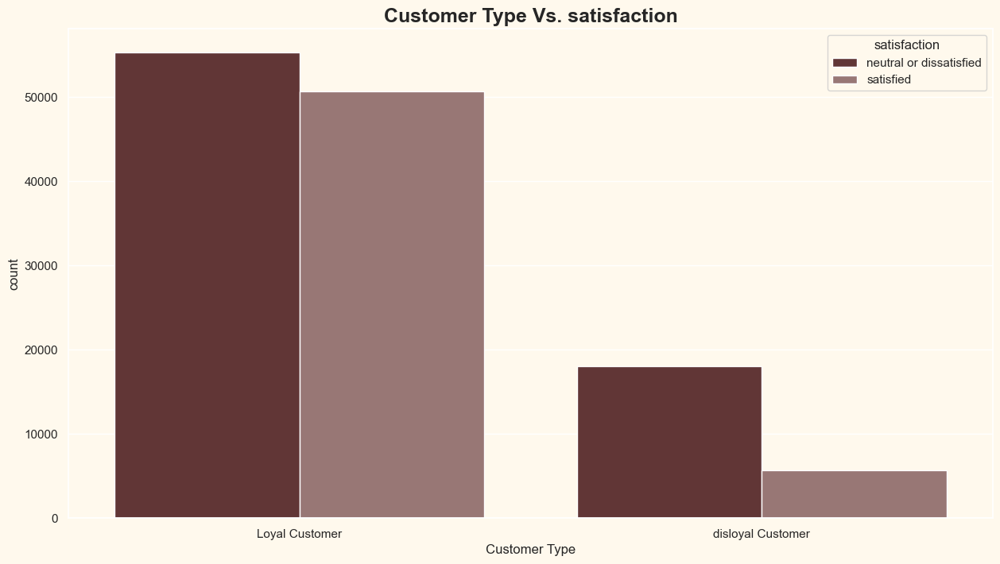

In [115]:
countplot_bi(df, "Customer Type", "satisfaction")

### 4.5 Multi-variate Analysis.

#### `1. How does the age or gender of passengers relate to their satisfaction levels?`

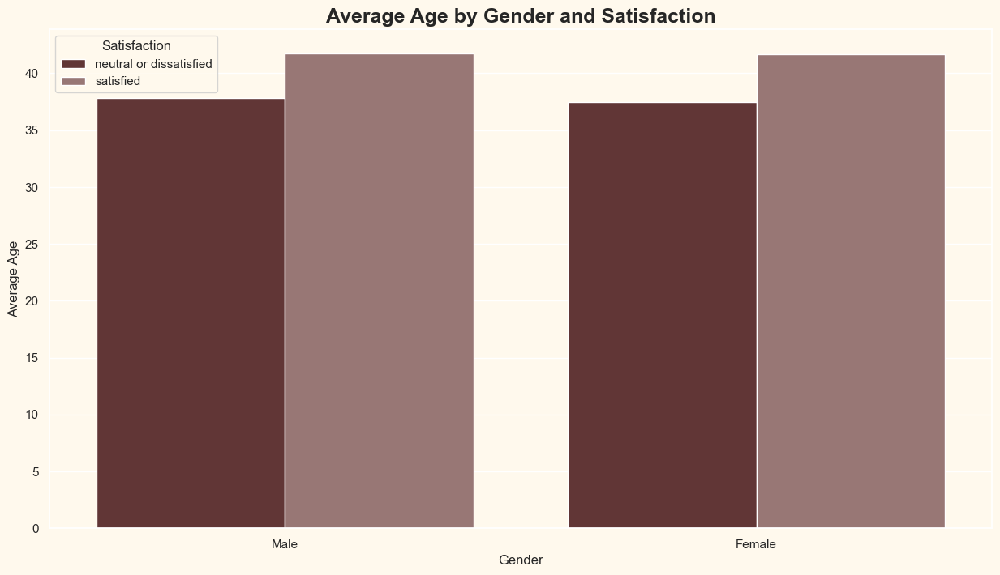

In [116]:
## barplot
sns.barplot(data=df, x="Gender", y="Age", hue="satisfaction", estimator='mean', errorbar=('ci', False))

## the plot labels and title
plt.title("Average Age by Gender and Satisfaction", fontsize=18, weight="bold")
plt.xlabel("Gender")
plt.ylabel("Average Age")

## the legend
plt.legend(title="Satisfaction", loc="best")

## Show the plot
plt.show()


####  `2. Arrival Delay Vs. Departure Delay by (satisfaction).`

In [117]:
fig = px.scatter(df, x="Arrival Delay in Minutes", y="Departure Delay in Minutes", color="satisfaction",
                 color_discrete_sequence=px.colors.qualitative.Antique)

fig.update_layout(
    title="<b>Relationship between Arrival Delay and Departure Delay",
    xaxis_title="Arrival Delay (Minutes)",
    yaxis_title="Departure Delay (Minutes)",
)

## Show plot
fig.show()

In [118]:
df["satisfaction"].unique()

array(['neutral or dissatisfied', 'satisfied'], dtype=object)

In [119]:
corr_satisfied = df[df["satisfaction"] == "satisfied"][["Arrival Delay in Minutes","Departure Delay in Minutes"]].corr().iloc[0,1]
corr_disatisfied = df[df["satisfaction"] == "neutral or dissatisfied"][["Arrival Delay in Minutes","Departure Delay in Minutes"]].corr().iloc[0,1]
print(f"the correlation between arrival delay and departure when satisfied = {corr_satisfied}")
print(f"the correlation between arrival delay and departure when satisfied = {corr_disatisfied}")

the correlation between arrival delay and departure when satisfied = 0.9521610862052585
the correlation between arrival delay and departure when satisfied = 0.9477049646128228


#### `3. How does the type of travel influence the satisfaction levels of individuals in terms of their food and drink experiences?`

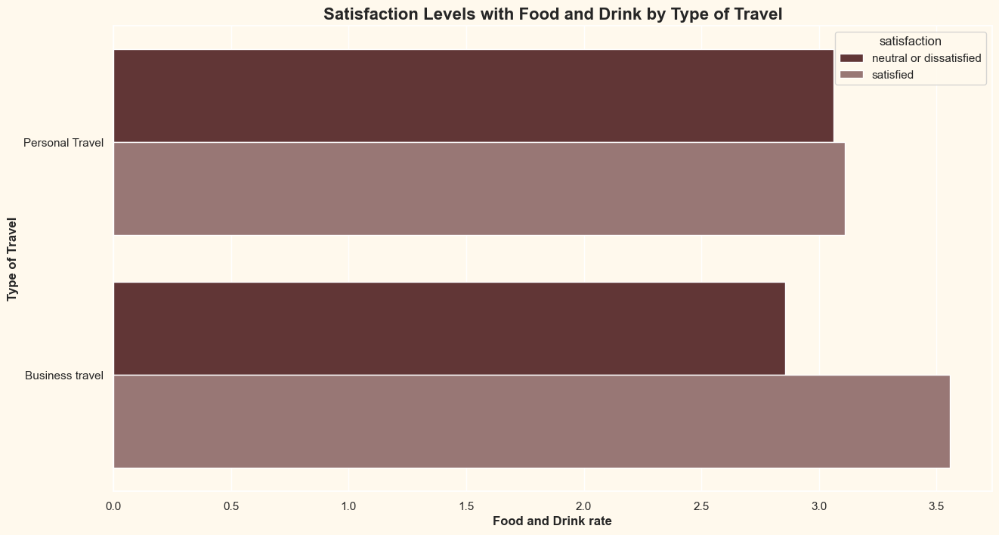

In [120]:
## Create the barplot using seaborn
sns.barplot(data=df, y="Type of Travel", x="Food and drink", hue="satisfaction",
            estimator="mean",  errorbar=('ci', False))  # Remove error bars

## labels and title
plt.xlabel("Food and Drink rate", weight="bold")  ## X-axis label
plt.ylabel("Type of Travel", weight="bold")  ## Y-axis label
plt.title("Satisfaction Levels with Food and Drink by Type of Travel", fontsize=16, weight="bold")  ## Plot title

## Display the plot
plt.show()

<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>It is Clear That :</h3>
<ul>
<li> <b>In personal travel, the average satisfaction rate with food and drink is equal in both cases (satisfied , dissatisfied).</b>
<li> <b>In business travel, the average rate of satisfaction with food and drink is higher in satisfied case than in dissatisfied case.</b>
</ul>
</div>

#### `4. Flight Distance by Satisfaction and Class.`

In [121]:
## sunburst chart using plotly
fig = px.sunburst(
    data_frame=df,  ## Data
    path=["satisfaction", "Class"],  ## Specify the hierarchical path
    values='Flight Distance',  ## Specify the values to be represented
    color_discrete_sequence=px.colors.qualitative.Antique  ## color scheme
)

## Update layout properties
fig.update_layout(
    title="<b>Flight Distance by Satisfaction and Class",  # Set the title
    height=500 # Set the height of the chart

)

## Update sunburst properties
fig.update_traces(
    textinfo='label+percent entry'  # Show label and percentage on the chart
)

## Display the chart
fig.show()

#### `5. Did your satisfaction with the check-in service vary depending on the type of travel experience?`

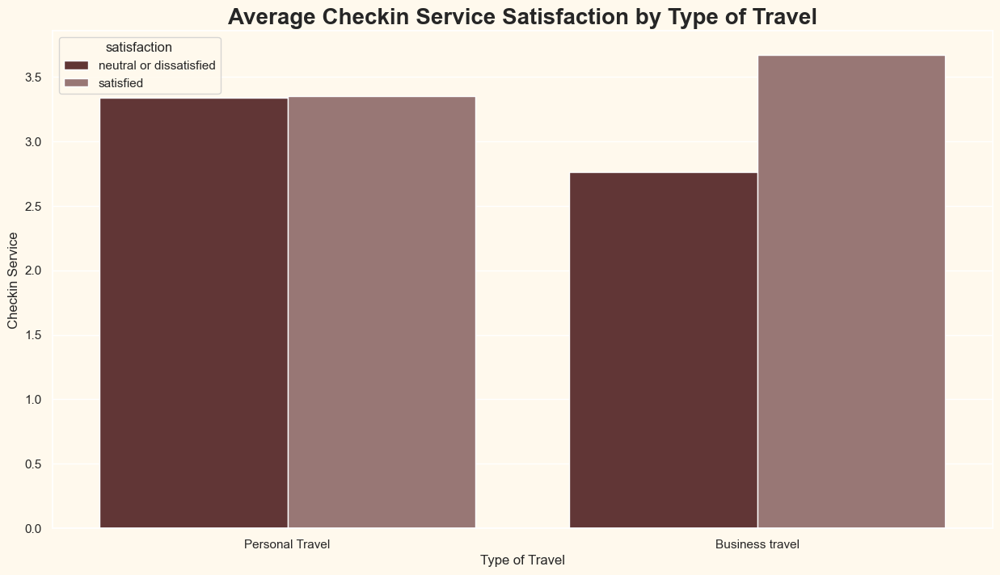

In [122]:
## Plot the bar plot using seaborn
sns.barplot(data=df, x="Type of Travel", y="Checkin service", hue="satisfaction", estimator="mean", errorbar=('ci', False))

## Add labels and title
plt.xlabel("Type of Travel")
plt.ylabel("Checkin Service")
plt.title("Average Checkin Service Satisfaction by Type of Travel", fontsize=20, weight="bold")

## show plot  
plt.show()

-----------------------------------------

## 5. Preprocessing for ML Model & Data PipeLine.


##### `5.1 Target Encoding` 

In [75]:
# The 'satisfaction' column will represent satisfaction levels, with 0 for 'neutral or dissatisfied' and 1 for 'satisfied'.
df["satisfaction"] = df["satisfaction"].map({"neutral or dissatisfied":0,
                                             "satisfied":1})

##### `5.2 Feature Selection USING FILTER METHOD.` 

##### `What is Feature Selection?`
> - **Feature Selection is the method of reducing the input variable to your model by using only 
relevant data and getting rid of noise in data .**
> - **Filter methods are generally used as a preprocessing step. The selection of features is independent of any machine learning algorithms. Instead, features are selected on the basis of their scores in various statistical tests for their correlation with the outcome variable.**

##### `Top reasons to use feature selection are:`

- It enables the machine learning algorithm to train faster.
- It reduces the complexity of a model and makes it easier to interpret.
- It improves the accuracy of a model if the right subset is chosen.
- It reduces overfitting.

In [76]:
df_copy = df.copy()

In [77]:
df_copy.select_dtypes("O").columns.to_list()

['Gender', 'Customer Type', 'Type of Travel', 'Class']

`Encode Categorical Features`

In [78]:
## Step 1: Create an instance of the OrdinalEncoder
##OHE = OneHotEncoder(drop='first', sparse_output=False)  ## Use 'sparse_output=False' to get a dense arrayظ
OL = OrdinalEncoder()

## Step 2: Perform OrdinalEncoder on selected categorical columns
feature_encoded = OL.fit_transform(df_copy[['Gender', 'Customer Type', 'Type of Travel', 'Class']])

## Step 3: Create a DataFrame from the one-hot encoded features with meaningful column names
df_encoded = pd.DataFrame(feature_encoded, columns=OL.get_feature_names_out(['Gender', 'Customer Type', 'Type of Travel', 'Class']))

## Step 4: reset index ... 
##df_selection = df_selection[~df_selection.index.duplicated(keep='last')]

df_copy.reset_index(drop=True, inplace=True)
df_encoded.reset_index(drop=True, inplace=True)

## Step 5: Drop the original categorical columns and 'Flight Distance log' (i will add it in the pipeline)

df_copy.drop(columns=['Gender', 'Customer Type', 'Type of Travel', 'Class', 'Flight Distance log'], inplace=True, axis=1)

## Step 6: Concatenate the original DataFrame with the one-hot encoded features
df_selection = pd.concat([df_copy, df_encoded], axis=1)

In [79]:
df_selection.sample(5)

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,Gender,Customer Type,Type of Travel,Class
124796,44,545,1,2,1,3,5,4,4,4,4,1,5,4,4,4,0.0,0.0,0,0.0,0.0,1.0,1.0
43171,39,1389,4,3,3,2,2,3,2,2,3,4,4,3,4,2,0.0,0.0,0,1.0,1.0,0.0,0.0
129133,51,1224,5,5,5,5,4,4,5,4,4,4,4,5,4,5,0.0,0.0,1,0.0,0.0,0.0,0.0
38743,69,2239,1,4,1,3,5,1,5,5,3,2,3,3,5,5,3.0,0.0,0,1.0,0.0,1.0,1.0
50981,44,1829,3,4,3,3,1,3,1,1,4,2,3,4,4,1,0.0,0.0,0,1.0,0.0,1.0,1.0


`impute NAN.`

In [80]:
imputer = SimpleImputer(strategy="median")
df_selection["Arrival Delay in Minutes"] = imputer.fit_transform(df_selection[["Arrival Delay in Minutes"]])

In [81]:
X_selection = df_selection.drop("satisfaction", axis=1)
y_selection = df["satisfaction"]

In [82]:
## STEP 1 : Create an instance of SelectKBest with the f_classif score function and select the top 15 features
best_feat = SelectKBest(score_func=f_classif, k=18)

## STEP 2 : Fit SelectKBest to the training data to compute feature scores and select the best features
fit_best = best_feat.fit(X_selection, y_selection)

## STEP 3 : Create a DataFrame to store the feature scores
df_scores = pd.DataFrame(fit_best.scores_)

## STEP 4 : Create a DataFrame to store the feature names (column names)
df_columns = pd.DataFrame(X_selection.columns)

## STEP 5 : Concatenate the feature names and their corresponding scores into a single DataFrame
features_score = pd.concat([df_columns, df_scores], axis=1)

## STEP 6 : Rename the columns for clarity
features_score.columns = ['Feature', 'Score']

## STEP 7 : Sort the DataFrame by feature scores in descending order to see the most important features first
features_score.sort_values(by=['Score'], inplace=True, ascending=False)

## STEP 8 : Print the DataFrame to see the feature scores and their corresponding names
features_score.style.background_gradient(cmap=color_map)

,Feature,Score
7,Online boarding,43698.252161
20,Type of Travel,32952.934552
21,Class,32647.730388
9,Inflight entertainment,24479.573892
8,Seat comfort,17993.257439
10,On-board service,15045.355578
11,Leg room service,14048.467148
15,Cleanliness,13517.980514
1,Flight Distance,12665.660936
2,Inflight wifi service,11347.420455


 <h4 style = "text-align:center; font-size:120%">Let's plot (features_score).</h4>

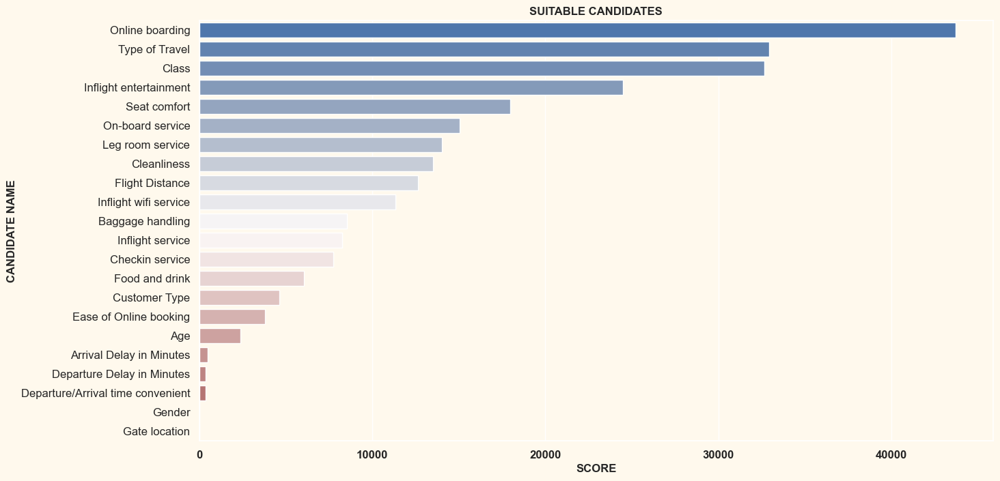

In [83]:
sns.barplot(data=features_score, x='Score', y='Feature', palette="vlag")
plt.title('SUITABLE CANDIDATES', weight='bold')
plt.xlabel('SCORE', weight='bold')
plt.ylabel('CANDIDATE NAME', weight='bold')
plt.xticks(fontsize=12, weight="bold")
plt.yticks(fontsize=12)
plt.show()

In [84]:
fit_best = best_feat.fit_transform(X_selection, y_selection)

In [85]:
df_selection = df[list(best_feat.get_feature_names_out())]

In [86]:
df_selection.sample()

,Age,Flight Distance,Inflight wifi service,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Arrival Delay in Minutes,Customer Type,Type of Travel,Class
52907,47,919,2,2,5,4,4,4,4,4,4,3,4,4,12.0,Loyal Customer,Business travel,Business


In [87]:
df_selection.shape

(129880, 18)

In [88]:
df.shape

(129880, 24)

##### `5.2 Split Data`

In [89]:
X = df_selection
y = df["satisfaction"] ## target

In [90]:
X.sample()

,Age,Flight Distance,Inflight wifi service,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Arrival Delay in Minutes,Customer Type,Type of Travel,Class
15032,14,1242,1,1,1,1,1,1,3,2,4,5,4,1,0.0,Loyal Customer,Personal Travel,Eco


In [91]:
## split train and test (0.75 for training, 0.25 for testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, shuffle=True, random_state=42, stratify=y)

print('X Train Shape is ==> ', X_train.shape)
print('y Train Shape is ==> ', y_train.shape)

print('='*30)
print('='*30)

print('X Test Shape is ==> ', X_test.shape)
print('y Test Shape is ==> ', y_test.shape)

X Train Shape is ==>  (97410, 18)
y Train Shape is ==>  (97410,)
X Test Shape is ==>  (32470, 18)
y Test Shape is ==>  (32470,)


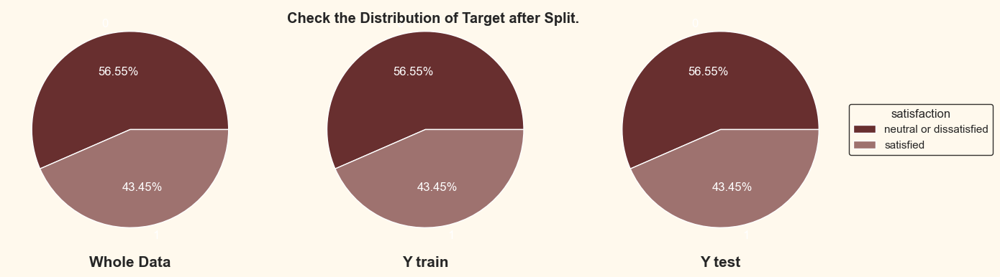

In [92]:
## Let's check the Distribution of target ==> Note i used Stratify When Spliting
## pie plot in matplotlib.pyplot
check_target = [y, y_train, y_test]
label_name = ["Whole Data", "Y train", "Y test"]

plt.suptitle("Check the Distribution of Target after Split.", weight='bold', x=0.52, y=0.7)

for idx, target_name in enumerate(check_target):
    
    label = label_name[idx]
    
    plt.subplot(1, 3, idx+1)
    plt.pie(x=target_name.value_counts().values, labels=target_name.value_counts().index, autopct="%.2f%%",
            textprops=dict(size= 12, color= "white"))
    
    plt.xlabel(label, fontsize=15, weight="bold")
    
plt.legend(labels, title="satisfaction",loc="center left",bbox_to_anchor=(1, 0, 0.5, 1), edgecolor = "black")
plt.show()

##### `5.3 Data PipeLine.` 

In [93]:
df_selection.columns.to_list()

['Age',
 'Flight Distance',
 'Inflight wifi service',
 'Ease of Online booking',
 'Food and drink',
 'Online boarding',
 'Seat comfort',
 'Inflight entertainment',
 'On-board service',
 'Leg room service',
 'Baggage handling',
 'Checkin service',
 'Inflight service',
 'Cleanliness',
 'Arrival Delay in Minutes',
 'Customer Type',
 'Type of Travel',
 'Class']

In [94]:
## store the column names for categorical.
categorical_cols =df_selection.select_dtypes(include="O").columns.to_list()

## list of column names representing numerical.
numerical_cols = ["Flight Distance", "Arrival Delay in Minutes", "Age"]

# Calculate the set of columns that are ready for data processing, which excludes categorical and numerical columns.
ready_cols = list(set(df_selection.columns.tolist()) - set(categorical_cols) - set(numerical_cols))

# Print the list of categorical columns.
print("Categorical Columns:")
print(categorical_cols)
print("=="*30)

# Print the list of numerical columns.
print("Numerical Columns:")
print(numerical_cols)
print("=="*30)

# Print the list of columns that are ready for data processing (neither categorical nor numerical).
print("Columns Ready for Processing:")
print(ready_cols)

all_columns = numerical_cols + categorical_cols + ready_cols

Categorical Columns:
['Customer Type', 'Type of Travel', 'Class']
Numerical Columns:
['Flight Distance', 'Arrival Delay in Minutes', 'Age']
Columns Ready for Processing:
['Ease of Online booking', 'Leg room service', 'Online boarding', 'Inflight service', 'Inflight wifi service', 'Food and drink', 'Inflight entertainment', 'Cleanliness', 'On-board service', 'Baggage handling', 'Seat comfort', 'Checkin service']


In [95]:
## Define a pipeline for processing numerical columns.
numerical_pipe = Pipeline(
    steps=[
        ("Selector", DataFrameSelector(numerical_cols)),  ## Select numerical columns
        ("impute", SimpleImputer(strategy="median")),     ## Impute missing values with median
        ("Transformer", FunctionTransformer(np.log1p)), ## using log transform
        ("Scaler", StandardScaler())                     ## Scale the numerical features ## RobustScaler
    ])

## Define a pipeline for processing categorical columns.
categorical_pipe = Pipeline(
    steps=[
        ("Selector", DataFrameSelector(categorical_cols)),        ## Select categorical columns
        ("impute", SimpleImputer(strategy='most_frequent')),     ## Impute missing values with most frequent value
        ("Encoding", OneHotEncoder(drop='first', sparse_output=False))  # One-hot encode categorical features
    ])

## Define a pipeline for processing columns that are "ready" for processing.
ready_pipe = Pipeline(
    steps=[
        ("Selector", DataFrameSelector(ready_cols)),  ## Select columns that are ready for processing
        ("impute", KNNImputer(n_neighbors=5)) ## Impute missing values using K-nearest neighbors
    ])

## Combine the numerical, categorical, and ready processing pipelines into one.

all_pipeline = FeatureUnion(
    transformer_list=[
        ('numerical', numerical_pipe),
        ('categorical', categorical_pipe),
        ('ready', ready_pipe)
    ])

## Transform the training data using the combined pipeline.
X_train_final = all_pipeline.fit_transform(X_train)

## Transform the test data using the same pipeline.
X_test_final = all_pipeline.transform(X_test)

##### `5.4 Handling with Imbalanced Target`

> - **`Using SMOTE`: Synthetic Minority Oversampling Technique.**
> - **SMOTE is an oversampling technique where the synthetic samples are generated for the minority class. This algorithm helps to overcome the overfitting problem posed by random oversampling.**
> - ***Source (SMOTE) : https://www.analyticsvidhya.com/blog/2020/10/overcoming-class-imbalance-using-smote-techniques/#h-smote-synthetic-minority-oversampling-technique***
> - **Using Class Weight**

`SMOTE`

In [96]:
# Apply SMOTE to balance the class distribution of your training data
# X_train_final is the feature matrix (training data)
# y_train is the target variable (training labels)

over_sampling = SMOTE()
X_train_resampled, y_train_resampled = over_sampling.fit_resample(X_train_final, y_train)

In [97]:
print("Y Train Before Resample :")
print(y_train.value_counts())
print("="*30)
print("Y Train After Resample :")
print(y_train_resampled.value_counts())

Y Train Before Resample :
0    55089
1    42321
Name: satisfaction, dtype: int64
Y Train After Resample :
0    55089
1    55089
Name: satisfaction, dtype: int64


`Class Weight`

In [98]:
np.bincount(y_train)

array([55089, 42321], dtype=int64)

In [99]:
## Calculate the class distribution imbalance by subtracting the normalized class counts
## from 1. This will result in a value that represents the imbalance for each class.
target_count = 1 - (np.bincount(y_train) / len(y_train))

## Normalize the class imbalance values by dividing them by their sum, so they add up to 1.
target_count = target_count / np.sum(target_count) 

## Create an empty dictionary to store the class weights.
class_weights  = {}

## Loop over the class indices (0 and 1) to assign class weights.
for i in range(2): ## 2 classes (0, 1)
    class_weights[i] = target_count[i]

## The 'dict_weights' dictionary now contains the calculated weights for each class.
class_weights 

{0: 0.4344625808438559, 1: 0.5655374191561442}

## 6. Modeling

`Model Performance Function`

In [100]:
def model_performance(model_name, model, X_train_data, X_test_data, y_train_data, y_test_data):
    
    '''
    Function to evaluate and display the performance of a machine learning model.
    
    Parameters:
    model_name (str): A string representing the name of the model.
    model: The trained machine learning model to be evaluated.
    X_train_data: Training data features.
    X_test_data: Testing data features.
    y_train_data: Training data labels.
    y_test_data: Testing data labels.
    '''
    
    # Make predictions on the training and testing data
    y_train_predicted = model.predict(X_train_data)
    y_test_predicted = model.predict(X_test_data)
    
    ## Print the model name
    print(f"==> Model and some Details: {model_name}")
    
    ## Separator for clarity
    print("**" * 30)
    
    ## Evaluate and print F1-score for training and testing data
    f1_score_training = round(f1_score(y_train_data, y_train_predicted), 3) * 100
    f1_score_testing = round(f1_score(y_test_data, y_test_predicted), 3) * 100
    print(f"F1-score for training data using {model_name} : {f1_score_training} %")
    print(f"F1-score for testing data using {model_name} : {f1_score_testing} %")
    
    ## Separator for clarity
    print("**" * 30)
    
    ## Evaluate and print Accuracy Score for training and testing data
    acc_score_training = round(accuracy_score(y_train_data, y_train_predicted), 3) * 100
    acc_score_testing = round(accuracy_score(y_test_data, y_test_predicted), 3) * 100
    print(f"Accuracy Score for training data using {model_name} : {acc_score_training} %")
    print(f"Accuracy Score for testing data using {model_name} : {acc_score_testing} %")

`Cross Validation Function`

In [101]:
## Define a custom scoring function for F1 score with 'micro' average
f1_scorer = make_scorer(f1_score, average='micro')

def cross_validation(model_name, model, X_valid, y_valid, CV=5, scoring=f1_scorer):
    """
    Perform cross-validation and print the results.

    Parameters:
    - model_name (str): A name or description of the model being evaluated.
    - model: The estimator or model to be evaluated.
    - X_valid: The input data for validation.
    - y_valid: The target labels for validation.
    - CV (int): The number of cross-validation folds.
    - scoring: Scoring function to use for evaluation (default is F1 score with 'micro' average).

    """

    ## Perform cross-validation
    validation_score = cross_validate(estimator=model, X=X_valid, y=y_valid, cv=CV, return_train_score=True, scoring=scoring)
    
    print(f"==> Model Name and Details > {model_name}")
    
    print("**" * 30)
    
    print(f"Train score : {round(validation_score['train_score'].mean(), 2)} \nstandard deviation For Train Score : {round(validation_score['train_score'].std(), 3)}")
    print("**" * 30)
    print(f"Test score : {round(validation_score['test_score'].mean(), 2)} \nstandard deviation For Test Score : {round(validation_score['test_score'].std(), 3)}")

`Confusion Matrix Function`

In [102]:
def conf_matrix(model, title=""):
    """
    Generate a confusion matrix heatmap for evaluating a machine learning model's performance.

    Parameters:
    - model: Trained machine learning model (classifier).
    - title: A title for the confusion matrix plot (optional).

    Returns:
    None
    """
    ## Use the trained model to make predictions on the test data
    y_predict = model.predict(X_test_final)

    ## Create a confusion matrix to evaluate the model's performance
    confusionMatrix = confusion_matrix(y_test, y_predict)

    ## Plot Using Seaborn
    plt.figure(figsize=(9, 7))  ## Set the figure size
    sns.heatmap(confusionMatrix, annot=True, fmt="d", cbar=False)

    ## Add labels and titles to the heatmap
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title(f"{title}")

    ## Show the heatmap
    plt.show()

### 6.1 Logistic Regression

#### `Without Solve Imbalancing.`

In [103]:
logistic_reg = LogisticRegression(random_state=42, solver='lbfgs', max_iter=1000)
logistic_reg.fit(X_train_final,y_train)

LogisticRegression(max_iter=1000, random_state=42)

In [104]:
model_performance(model_name="Logistic Regression Without Solve Imbalancing",
                  model=logistic_reg,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Logistic Regression Without Solve Imbalancing
************************************************************
F1-score for training data using Logistic Regression Without Solve Imbalancing : 85.3 %
F1-score for testing data using Logistic Regression Without Solve Imbalancing : 85.1 %
************************************************************
Accuracy Score for training data using Logistic Regression Without Solve Imbalancing : 87.5 %
Accuracy Score for testing data using Logistic Regression Without Solve Imbalancing : 87.3 %


In [105]:
cross_validation(model_name="Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && Without Solve Imbalancing.",
                 model=logistic_reg,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && Without Solve Imbalancing.
************************************************************
Train score : 0.87 
standard deviation For Train Score : 0.001
************************************************************
Test score : 0.87 
standard deviation For Test Score : 0.002


In [106]:
## dumb Logistic Regression...
joblib.dump(logistic_reg, 'logistic_reg.pkl')

['logistic_reg.pkl']

#### `With Solve Imbalancing Using SMOTE.`

In [107]:
logistic_reg_smote = LogisticRegression(random_state=42, solver='lbfgs', max_iter=1000)
logistic_reg_smote.fit(X_train_resampled,y_train_resampled)

LogisticRegression(max_iter=1000, random_state=42)

In [108]:
model_performance(model_name="Logistic Regression With Solve Imbalancing Using SMOTE.",
                  model=logistic_reg_smote,
                  X_train_data=X_train_resampled,
                  X_test_data=X_test_final,
                  y_train_data=y_train_resampled,
                  y_test_data=y_test)

==> Model and some Details: Logistic Regression With Solve Imbalancing Using SMOTE.
************************************************************
F1-score for training data using Logistic Regression With Solve Imbalancing Using SMOTE. : 86.8 %
F1-score for testing data using Logistic Regression With Solve Imbalancing Using SMOTE. : 84.89999999999999 %
************************************************************
Accuracy Score for training data using Logistic Regression With Solve Imbalancing Using SMOTE. : 86.9 %
Accuracy Score for testing data using Logistic Regression With Solve Imbalancing Using SMOTE. : 86.8 %


In [109]:
cross_validation(model_name="Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && With Solve Imbalancing Using SMOTE.",
                 model=logistic_reg_smote,
                 X_valid=X_train_resampled,
                 y_valid=y_train_resampled)

==> Model Name and Details > Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && With Solve Imbalancing Using SMOTE.
************************************************************
Train score : 0.87 
standard deviation For Train Score : 0.001
************************************************************
Test score : 0.87 
standard deviation For Test Score : 0.003


#### `With Solve Imbalancing Using Class Weights.`

In [110]:
logistic_reg_weights = LogisticRegression(random_state=42, solver='lbfgs', max_iter=1000, class_weight=class_weights)
logistic_reg_weights.fit(X_train_final,y_train)

LogisticRegression(class_weight={0: 0.4344625808438559, 1: 0.5655374191561442},
                   max_iter=1000, random_state=42)

In [111]:
model_performance(model_name="Logistic Regression With Solve Imbalancing Using Class Weights.",
                  model=logistic_reg_weights,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Logistic Regression With Solve Imbalancing Using Class Weights.
************************************************************
F1-score for training data using Logistic Regression With Solve Imbalancing Using Class Weights. : 85.1 %
F1-score for testing data using Logistic Regression With Solve Imbalancing Using Class Weights. : 84.89999999999999 %
************************************************************
Accuracy Score for training data using Logistic Regression With Solve Imbalancing Using Class Weights. : 86.9 %
Accuracy Score for testing data using Logistic Regression With Solve Imbalancing Using Class Weights. : 86.8 %


In [112]:
cross_validation(model_name="Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && With Solve Imbalancing Using Class Weights.",
                 model=logistic_reg_weights,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using Estimator Logistic Regression && Scoring=f1-score && With Solve Imbalancing Using Class Weights.
************************************************************
Train score : 0.87 
standard deviation For Train Score : 0.001
************************************************************
Test score : 0.87 
standard deviation For Test Score : 0.002


`Confusion Matrix for LogisticRegression Without Solve Imbalancing.`

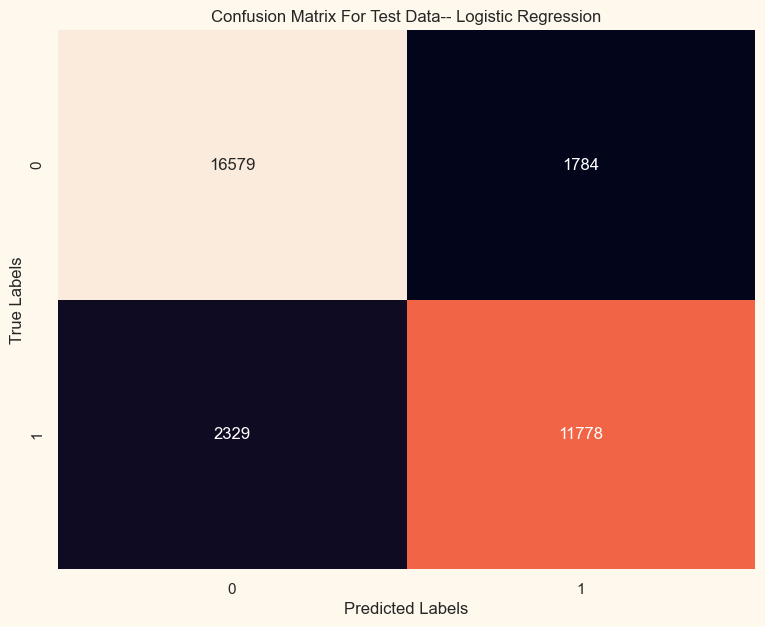

In [113]:
conf_matrix(model=logistic_reg,
            title="Confusion Matrix For Test Data-- logistic Regression".title())

<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>Conclusion:</h3>
<ul>
<li> <b>The logistic regression model (Without Solving Imbalance, With Solving Imbalance) shows that the two are closely aligned in performance (f1-score), but Without Solving Imbalance achieves a slightly higher score.</b>
</ul>
</div>


### 6.2 K-Nearest Neighbors Algorithm

#### `Without Solve Imbalancing.`

In [114]:
## Create a KNN classifier with specific parameters:
## - n_neighbors: The number of neighbors to consider (in this case, 5)
## - p: The power parameter for the Minkowski distance (in this case, 4, indicating the Manhattan distance)
## - n_jobs: Number of CPU cores to use for parallel processing (in this case, -1 means to use all available cores)
KNN_clf = KNeighborsClassifier(n_neighbors=5, p=4, n_jobs=-1)

## Train the KNN classifier on the training data
KNN_clf.fit(X_train_final, y_train)

KNeighborsClassifier(n_jobs=-1, p=4)

In [115]:
model_performance(model_name="K-Nearest Neighbors Algorithm Without Solve Imbalancing",
                  model=KNN_clf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: K-Nearest Neighbors Algorithm Without Solve Imbalancing
************************************************************
F1-score for training data using K-Nearest Neighbors Algorithm Without Solve Imbalancing : 93.7 %
F1-score for testing data using K-Nearest Neighbors Algorithm Without Solve Imbalancing : 90.9 %
************************************************************
Accuracy Score for training data using K-Nearest Neighbors Algorithm Without Solve Imbalancing : 94.6 %
Accuracy Score for testing data using K-Nearest Neighbors Algorithm Without Solve Imbalancing : 92.30000000000001 %


In [116]:
## dumb KNN classifier...
joblib.dump(KNN_clf, 'KNN_clf.pkl')

['KNN_clf.pkl']

#### `With Solve Imbalancing Using SMOTE.`

In [117]:
KNN_clf_smote = KNeighborsClassifier(n_neighbors=5, p=4, n_jobs=-1)
KNN_clf_smote.fit(X_train_resampled, y_train_resampled)

KNeighborsClassifier(n_jobs=-1, p=4)

In [118]:
model_performance(model_name="K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE.",
                  model=KNN_clf_smote,
                  X_train_data=X_train_resampled,
                  X_test_data=X_test_final,
                  y_train_data=y_train_resampled,
                  y_test_data=y_test)

==> Model and some Details: K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE.
************************************************************
F1-score for training data using K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE. : 95.39999999999999 %
F1-score for testing data using K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE. : 90.8 %
************************************************************
Accuracy Score for training data using K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE. : 95.39999999999999 %
Accuracy Score for testing data using K-Nearest Neighbors Algorithm With Solve Imbalancing Using SMOTE. : 92.0 %


`Confusion Matrix for KNN Without Solve Imbalancing.`

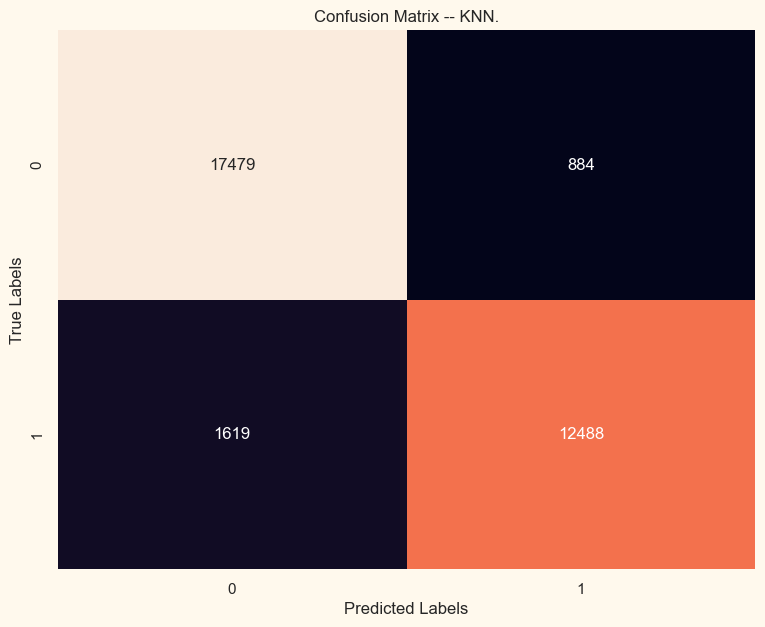

In [119]:
conf_matrix(model=KNN_clf,
            title="Confusion Matrix -- KNN.")

### 6.3 Naïve Bayes Classifier.

#### `Without Solve Imbalancing.`

In [120]:
# Create an instance of the Gaussian Naive Bayes classifier
NAIVE_clf = GaussianNB()

# Fit the classifier to the training data
NAIVE_clf.fit(X_train_final, y_train)

GaussianNB()

In [121]:
model_performance(model_name="Naïve Bayes Classifier Without Solve Imbalancing",
                  model=NAIVE_clf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Naïve Bayes Classifier Without Solve Imbalancing
************************************************************
F1-score for training data using Naïve Bayes Classifier Without Solve Imbalancing : 83.89999999999999 %
F1-score for testing data using Naïve Bayes Classifier Without Solve Imbalancing : 83.89999999999999 %
************************************************************
Accuracy Score for training data using Naïve Bayes Classifier Without Solve Imbalancing : 86.4 %
Accuracy Score for testing data using Naïve Bayes Classifier Without Solve Imbalancing : 86.4 %


In [122]:
## dumb Naive bayes.
joblib.dump(NAIVE_clf, 'NAIVE_clf.pkl')

['NAIVE_clf.pkl']

#### `With Solve Imbalancing Using SMOTE.`

In [123]:
NAIVE_clf_smote = GaussianNB()
NAIVE_clf_smote.fit(X_train_resampled, y_train_resampled) 

GaussianNB()

In [124]:
model_performance(model_name="Naïve Bayes Classifier Without Solve Imbalancing",
                  model=NAIVE_clf_smote,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Naïve Bayes Classifier Without Solve Imbalancing
************************************************************
F1-score for training data using Naïve Bayes Classifier Without Solve Imbalancing : 83.7 %
F1-score for testing data using Naïve Bayes Classifier Without Solve Imbalancing : 83.7 %
************************************************************
Accuracy Score for training data using Naïve Bayes Classifier Without Solve Imbalancing : 86.1 %
Accuracy Score for testing data using Naïve Bayes Classifier Without Solve Imbalancing : 86.1 %


### 6.4 Support Vector Machine

#### 6.4.1 SVC Using Poly Kernal.

#### `Without Solve Imbalancing.`

In [125]:
# Create an instance of the Support Vector Machine (SVM) classifier with specified parameters:
# - C: The regularization parameter. In this case, C=2.
# - kernel: The kernel function used for classification. Here, we're using a polynomial kernel.
# - degree: The degree of the polynomial kernel. In this case, degree=3.
SVC_clf = SVC(C=2, kernel="poly", degree=3)

# Fit the SVM classifier to the training data
SVC_clf.fit(X_train_final, y_train)

SVC(C=2, kernel='poly')

In [126]:
model_performance(model_name="Support Vector Machine (Ploy Kernal) Without Solve Imbalancing.",
                  model=SVC_clf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Support Vector Machine (Ploy Kernal) Without Solve Imbalancing.
************************************************************
F1-score for training data using Support Vector Machine (Ploy Kernal) Without Solve Imbalancing. : 92.9 %
F1-score for testing data using Support Vector Machine (Ploy Kernal) Without Solve Imbalancing. : 92.80000000000001 %
************************************************************
Accuracy Score for training data using Support Vector Machine (Ploy Kernal) Without Solve Imbalancing. : 94.0 %
Accuracy Score for testing data using Support Vector Machine (Ploy Kernal) Without Solve Imbalancing. : 93.89999999999999 %


#### `With Solve Imbalancing Using SMOTE.`

In [127]:
SVC_clf_smote = SVC(C=2, kernel="poly", degree=3)
SVC_clf_smote.fit(X_train_resampled, y_train_resampled)

SVC(C=2, kernel='poly')

In [128]:
model_performance(model_name="Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE.",
                  model=SVC_clf_smote,
                  X_train_data=X_train_resampled,
                  X_test_data=X_test_final,
                  y_train_data=y_train_resampled,
                  y_test_data=y_test)

==> Model and some Details: Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE.
************************************************************
F1-score for training data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE. : 93.89999999999999 %
F1-score for testing data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE. : 92.9 %
************************************************************
Accuracy Score for training data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE. : 94.0 %
Accuracy Score for testing data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using SMOTE. : 93.89999999999999 %


#### `With Solve Imbalancing Using Class Weights.`

In [129]:
SVC_clf_weights = SVC(C=2, kernel="poly", degree=3, class_weight=class_weights)
SVC_clf_weights.fit(X_train_final, y_train)

SVC(C=2, class_weight={0: 0.4344625808438559, 1: 0.5655374191561442},
    kernel='poly')

In [130]:
model_performance(model_name="Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights.",
                  model=SVC_clf_weights,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights.
************************************************************
F1-score for training data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights. : 92.80000000000001 %
F1-score for testing data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights. : 92.60000000000001 %
************************************************************
Accuracy Score for training data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights. : 93.8 %
Accuracy Score for testing data using Support Vector Machine (Ploy Kernal) With Solve Imbalancing Using Class Weights. : 93.60000000000001 %


<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>Conclusion:</h3>
<ul>
<li> <b>The best performance I achieved when using the SVC with a polynomial kernel was when I used the original data without dealing with the imbalanced data (F1-Score) (92.8%).</b>
</ul>
</div>


#### `Let's Try RPF Kernal.`

#### 6.4.2 SVC Using RBF Kernal.

In [131]:
# Create an instance of the Support Vector Machine (SVM) classifier with specified parameters:
# - C: The regularization parameter. In this case, C=2.
# - kernel: The kernel function used for classification. Here, we're using a radial basis function (RBF) kernel.
# - gamma: The kernel coefficient for the RBF kernel. In this case, gamma=0.1.
SVC_clf_rbf = SVC(C=2, kernel='rbf', gamma=0.1, probability=True)

# Fit the SVM classifier to the training data
SVC_clf_rbf.fit(X_train_final, y_train)

SVC(C=2, gamma=0.1, probability=True)

In [132]:
model_performance(model_name="Support Vector Machine (RBF Kernal) Without Solve Imbalancing.",
                  model=SVC_clf_rbf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Support Vector Machine (RBF Kernal) Without Solve Imbalancing.
************************************************************
F1-score for training data using Support Vector Machine (RBF Kernal) Without Solve Imbalancing. : 96.7 %
F1-score for testing data using Support Vector Machine (RBF Kernal) Without Solve Imbalancing. : 95.0 %
************************************************************
Accuracy Score for training data using Support Vector Machine (RBF Kernal) Without Solve Imbalancing. : 97.2 %
Accuracy Score for testing data using Support Vector Machine (RBF Kernal) Without Solve Imbalancing. : 95.8 %


`Cross Validation (SVC Using RBF Kernal)`

In [133]:
cross_validation(model_name="Cross Validation Using Estimator SVC Using Poly kernal && Scoring=f1-score",
                 model=SVC_clf_rbf,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using Estimator SVC Using Poly kernal && Scoring=f1-score
************************************************************
Train score : 0.97 
standard deviation For Train Score : 0.0
************************************************************
Test score : 0.96 
standard deviation For Test Score : 0.001


`Confusion Matrix (SVC Using RBF Kernal)`

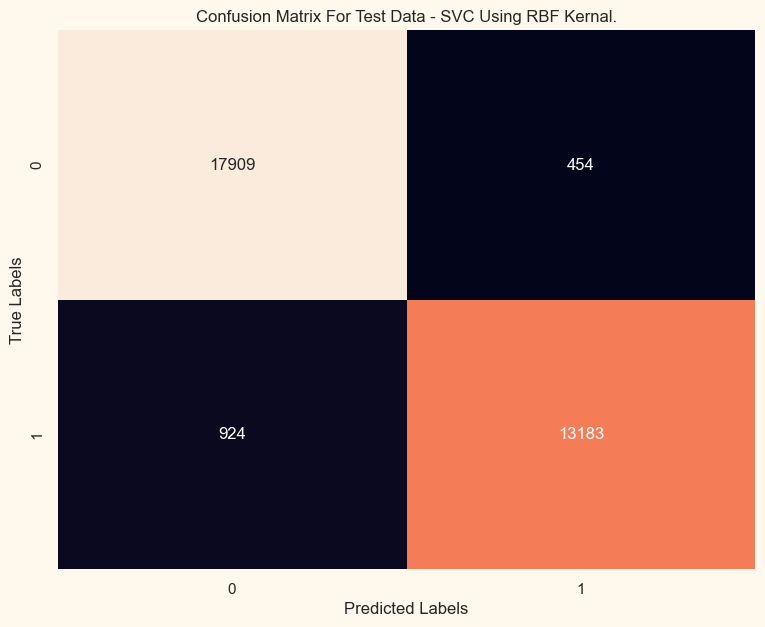

In [134]:
conf_matrix(model=SVC_clf_rbf,
            title="Confusion Matrix For Test Data - SVC Using RBF Kernal.")

In [135]:
## dumb SVC using rbf kernal
joblib.dump(SVC_clf_rbf, 'SVC_clf_rbf.pkl')

['SVC_clf_rbf.pkl']

<div style=" background-color:#FFF9ED;
            text-align:center;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>It is evident that the performance using the RBF kernel (F1-Score) (95%) is better than that using the polynomial kernel.
</h3>
</div>

### 6.5 Random Forest.

> - **Ensemble Learning**
> - **Bagging**

#### `Without Solve Imbalancing.`

In [136]:
# Create a Random Forest classifier with specific parameters:
# - n_estimators: The number of decision trees in the forest (in this case, 200)
# - max_depth: The maximum depth of each decision tree (in this case, 12)
# - random_state: A seed value for random number generation to ensure reproducibility (in this case, 45)
RF_clf = RandomForestClassifier(n_estimators=200, max_depth=12, random_state=45)

# Train the Random Forest classifier on the training data
RF_clf.fit(X_train_final, y_train)

RandomForestClassifier(max_depth=12, n_estimators=200, random_state=45)

In [137]:
model_performance(model_name="Random Forest Without Solve Imbalancing.",
                  model=RF_clf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Random Forest Without Solve Imbalancing.
************************************************************
F1-score for training data using Random Forest Without Solve Imbalancing. : 95.39999999999999 %
F1-score for testing data using Random Forest Without Solve Imbalancing. : 94.39999999999999 %
************************************************************
Accuracy Score for training data using Random Forest Without Solve Imbalancing. : 96.0 %
Accuracy Score for testing data using Random Forest Without Solve Imbalancing. : 95.19999999999999 %


`Cross validation`

In [138]:
cross_validation(model_name="Cross Validation Using Estimator (Random Forest) && Scoring=f1-score && Without Solve Imbalancing.",
                 model=RF_clf,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using Estimator (Random Forest) && Scoring=f1-score && Without Solve Imbalancing.
************************************************************
Train score : 0.96 
standard deviation For Train Score : 0.0
************************************************************
Test score : 0.95 
standard deviation For Test Score : 0.001


#### `With Solve Imbalancing Using SMOTE.`

In [139]:
RF_clf_smote = RandomForestClassifier(n_estimators=200, max_depth=12, random_state=45)
RF_clf_smote.fit(X_train_resampled, y_train_resampled)

RandomForestClassifier(max_depth=12, n_estimators=200, random_state=45)

In [140]:
model_performance(model_name="Random Forest With Solve Imbalancing Using SMOTE.",
                  model=RF_clf_smote,
                  X_train_data=X_train_resampled,
                  X_test_data=X_test_final,
                  y_train_data=y_train_resampled,
                  y_test_data=y_test)

==> Model and some Details: Random Forest With Solve Imbalancing Using SMOTE.
************************************************************
F1-score for training data using Random Forest With Solve Imbalancing Using SMOTE. : 96.1 %
F1-score for testing data using Random Forest With Solve Imbalancing Using SMOTE. : 94.3 %
************************************************************
Accuracy Score for training data using Random Forest With Solve Imbalancing Using SMOTE. : 96.1 %
Accuracy Score for testing data using Random Forest With Solve Imbalancing Using SMOTE. : 95.0 %


#### `With Solve Imbalancing Using Class Weights.`

In [141]:
RF_clf_weights = RandomForestClassifier(n_estimators=200, max_depth=12, random_state=45, class_weight=class_weights)
RF_clf_weights.fit(X_train_final, y_train)

RandomForestClassifier(class_weight={0: 0.4344625808438559,
                                     1: 0.5655374191561442},
                       max_depth=12, n_estimators=200, random_state=45)

In [142]:
model_performance(model_name="Random Forest With Solve Imbalancing Using Class Weights.",
                  model=RF_clf_smote,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Random Forest With Solve Imbalancing Using Class Weights.
************************************************************
F1-score for training data using Random Forest With Solve Imbalancing Using Class Weights. : 95.1 %
F1-score for testing data using Random Forest With Solve Imbalancing Using Class Weights. : 94.3 %
************************************************************
Accuracy Score for training data using Random Forest With Solve Imbalancing Using Class Weights. : 95.8 %
Accuracy Score for testing data using Random Forest With Solve Imbalancing Using Class Weights. : 95.0 %


#### `Confusion Matrix (RF).` 

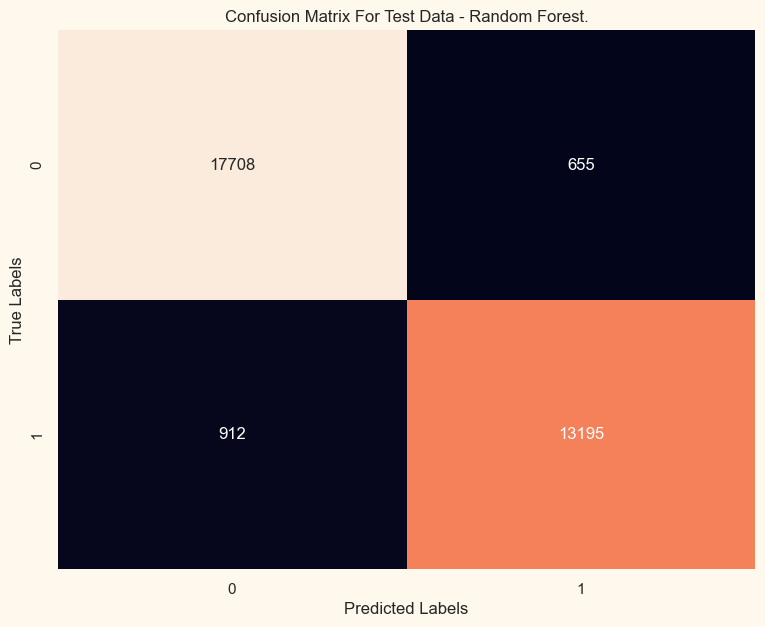

In [143]:
conf_matrix(model=RF_clf,
            title="Confusion Matrix For Test Data - Random Forest.".title())

<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>Conclusion:</h3>
<ul>
<li> <b>So far, the Random Forest algorithm has outperformed (Logistic Regression and K-Nearest Neighbors) in terms of performance (F1-Score) (94.5%).</b>
</ul>
</div>


### 6.5.1 Random Forest Hyperparameters Tuning Using Grid Search.

In [144]:
# Define the hyperparameter grid for Random Forest
param_grid_forest = {
    'n_estimators': np.arange(50, 250, 50),    # Test different values for the number of estimators
    'max_depth': np.arange(4, 15, 1),        # Test different values for the maximum depth of trees
    'max_features': [0.7, 0.9]              # Test different values for the maximum features to consider
}

## Create a GridSearchCV object to perform hyperparameter tuning
## verbose=4 indicates that you'll see more detailed information during the search, including progress updates and best parameters.
grid_search_forest = GridSearchCV(estimator=RF_clf, param_grid=param_grid_forest, cv=5, n_jobs=-1, scoring=f1_scorer, verbose=4)

# Fit the grid search to the training data
grid_search_forest.fit(X_train_final, y_train)

# Print the best F1 score and the corresponding hyperparameters
print(f"F1 Score For best Hyperparameters ==> {grid_search_forest.best_score_}")
print(f"Best Hyperparameters ==> {grid_search_forest.best_params_}")

Fitting 5 folds for each of 88 candidates, totalling 440 fits
F1 Score For best Hyperparameters ==> 0.9616877117339083
Best Hyperparameters ==> {'max_depth': 14, 'max_features': 0.7, 'n_estimators': 200}


<div style=" background-color:#FFF9ED;
            text-align:left;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>Conclusion:</h3>
<ul>
<li> <b>Fitting 5 folds for each of 88 candidates, totalling 440 fits.</b>
<li> <b>F1 Score For best Hyperparameters : 0.9615439893234781</b>
<li> <b>Best Hyperparameters : {'max_depth': 14, 'max_features': 0.7, 'n_estimators': 200}.</b>
</ul>
</div>

### 6.5.2 Retrain Random Forest After Tuning.

In [145]:
RF_Tuned = grid_search_forest.best_estimator_
RF_Tuned.fit(X_train_final,y_train)

RandomForestClassifier(max_depth=14, max_features=0.7, n_estimators=200,
                       random_state=45)

In [146]:
model_performance(model_name="Random Forest Aftet Tunning.",
                  model=RF_Tuned,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Random Forest Aftet Tunning.
************************************************************
F1-score for training data using Random Forest Aftet Tunning. : 97.0 %
F1-score for testing data using Random Forest Aftet Tunning. : 95.39999999999999 %
************************************************************
Accuracy Score for training data using Random Forest Aftet Tunning. : 97.39999999999999 %
Accuracy Score for testing data using Random Forest Aftet Tunning. : 96.1 %


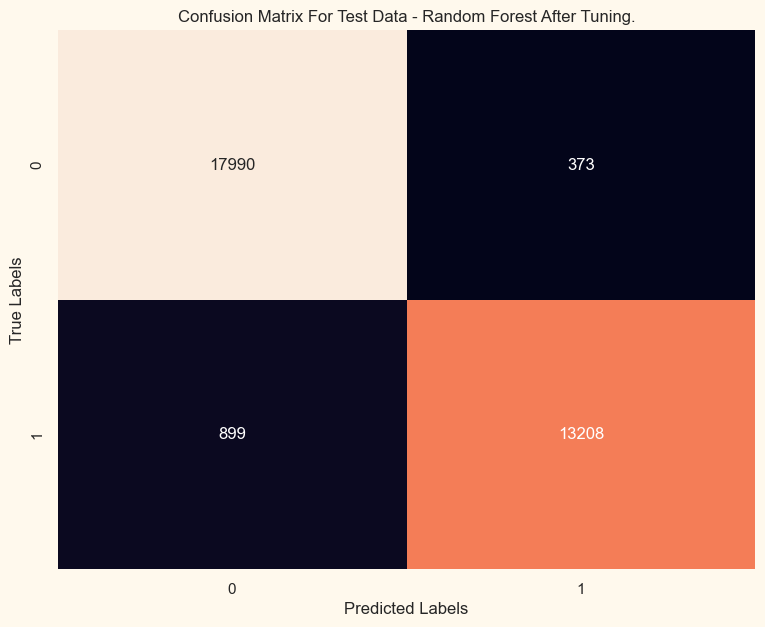

In [147]:
conf_matrix(model=RF_Tuned,
            title="Confusion Matrix For Test Data - Random Forest After Tuning.".title())

<div style=" background-color:#FFF9ED;
            text-align:center;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>Random Forest Performance After Tuning (F1-Score)= 95.5%</h3>
</div>

In [148]:
## dumb random forest algo. after tuning...
joblib.dump(RF_Tuned, 'random forest.pkl')

['random forest.pkl']

### 6.5.3 Feature Importance using Random Forest

In [149]:
feature_score = {}

for feature, score in zip(all_columns, RF_Tuned.feature_importances_):
    feature_score[feature] = score
    
keys_feature_score = feature_score.keys()
values_feature_score = feature_score.values()

df_feature_importance = pd.DataFrame({'Features': keys_feature_score, 'Score_using_RF': values_feature_score})
df_feature_importance.sort_values(by='Score_using_RF', ascending=False, inplace=True)
df_feature_importance.head()

,Features,Score_using_RF
9,Inflight service,0.335606
11,Food and drink,0.185037
4,Type of Travel,0.135507
5,Class,0.057105
13,Cleanliness,0.055373


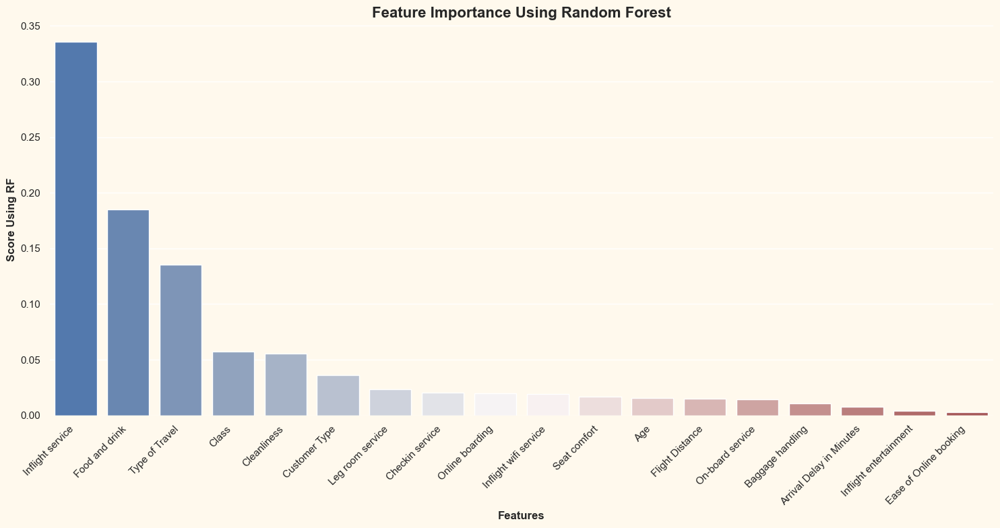

In [150]:
## Create the barplot Using seaborn to plot df_feature_imp..
sns.barplot(data=df_feature_importance, x='Features', y='Score_using_RF', palette='vlag')

plt.title("Feature Importance Using Random Forest", fontsize=16, weight="bold")  ## Add a title
plt.xlabel("Features", fontsize=12, weight="bold")  ## x-axis Label
plt.ylabel("Score Using RF", fontsize=12, weight="bold")  ## y-axis Label

plt.xticks(rotation=45, ha="right")  ## Rotate x-axis label

sns.despine(left=True, bottom=True)  

## Show the plot
plt.tight_layout()
plt.show()

### 6.6 Voting Classifier
> - **Ensemble Learning.**
> - **A Voting Classifier is a machine learning model that trains on an ensemble of numerous models and predicts an output (class) based on their highest probability of chosen class as the output.**
> - **It simply aggregates the findings of each classifier passed into Voting Classifier and predicts the output class based on the highest majority of voting. The idea is instead of creating separate dedicated models and finding the accuracy for each them, we create a single model which trains by these models and predicts output based on their combined majority of voting for each output class.**

> `Voting Classifier supports two types of votings.`
> - 1. **`Hard Voting`: In hard voting, the predicted output class is a class with the highest majority of votes i.e the class which had the highest probability of being predicted by each of the classifiers.**
> - 2. **`Soft Voting`: In soft voting, the output class is the prediction based on the average of probability given to that class.**

***Source : https://www.geeksforgeeks.org/ml-voting-classifier-using-sklearn/***

In [151]:
voting = VotingClassifier(
    estimators=[
        ("SVC", SVC_clf_rbf),         # Support Vector Machine with RBF kernel
        ("logistic_reg", logistic_reg),  # Logistic Regression
        ("naive", NAIVE_clf)          # Gaussian Naive Bayes
    ],
    voting="soft",  # Use "soft" voting for probability-based combination
    weights=[2,1,1]
)

voting.fit(X_train_final, y_train)

VotingClassifier(estimators=[('SVC', SVC(C=2, gamma=0.1, probability=True)),
                             ('logistic_reg',
                              LogisticRegression(max_iter=1000,
                                                 random_state=42)),
                             ('naive', GaussianNB())],
                 voting='soft', weights=[2, 1, 1])

`Performance for Voting Classifier.`

In [152]:
model_performance(model_name="Voting Classifier.",
                  model=voting,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: Voting Classifier.
************************************************************
F1-score for training data using Voting Classifier. : 94.19999999999999 %
F1-score for testing data using Voting Classifier. : 92.9 %
************************************************************
Accuracy Score for training data using Voting Classifier. : 95.1 %
Accuracy Score for testing data using Voting Classifier. : 94.0 %


`Confusion Matrix (Voting Classifier).`

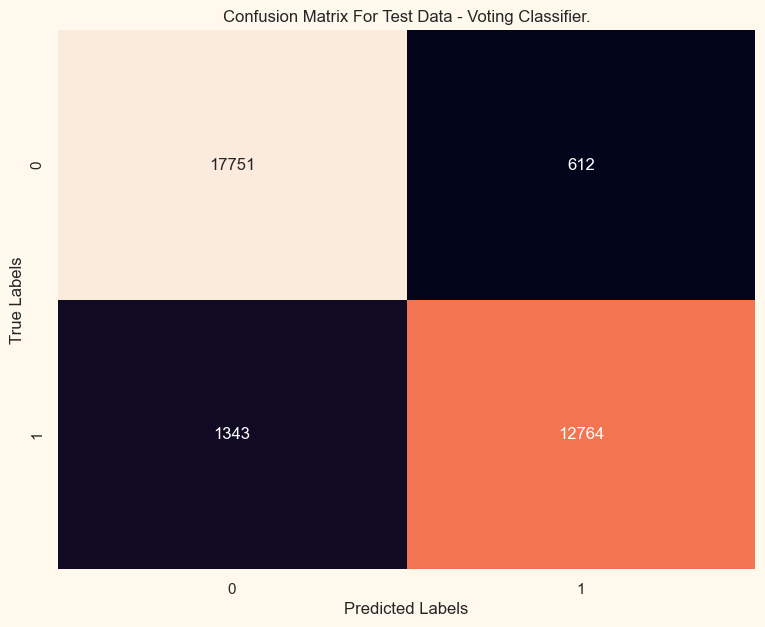

In [153]:
conf_matrix(model=voting,
            title="Confusion Matrix For Test Data - Voting Classifier.".title())

### 6.7 XGBOOST


#### `Without Solve Imbalancing.`

In [154]:
# Create an XGBoost classifier
XGB_clf = XGBClassifier(
    objective='binary:logistic', ## Specify the objective function for binary classification
    n_estimators=150, ## Number of boosting rounds (trees) to build in the ensemble
    max_depth=5, ## Maximum depth of each tree in the ensemble
    colsample_bytree=0.8, ## Fraction of features to be randomly selected for building each tree
    subsample=0.9, ## Fraction of the training data to be used for building each tree
    reg_lambda=100, ## L2 regularization term to control overfitting
    learning_rate=0.2 ## Learning rate for controlling the step size during optimization
)

XGB_clf.fit(X_train_final, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=150, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

`Model Performance` 

In [155]:
model_performance(model_name="XGBClassifier Without Solve Imbalancing.",
                  model=XGB_clf,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: XGBClassifier Without Solve Imbalancing.
************************************************************
F1-score for training data using XGBClassifier Without Solve Imbalancing. : 95.5 %
F1-score for testing data using XGBClassifier Without Solve Imbalancing. : 95.19999999999999 %
************************************************************
Accuracy Score for training data using XGBClassifier Without Solve Imbalancing. : 96.1 %
Accuracy Score for testing data using XGBClassifier Without Solve Imbalancing. : 95.89999999999999 %


`Cross Validation`

In [156]:
cross_validation(model_name="Cross Validation Using XGBClassifier && Scoring=f1-score && Without Solve Imbalancing.",
                 model=XGB_clf,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using XGBClassifier && Scoring=f1-score && Without Solve Imbalancing.
************************************************************
Train score : 0.96 
standard deviation For Train Score : 0.0
************************************************************
Test score : 0.96 
standard deviation For Test Score : 0.001


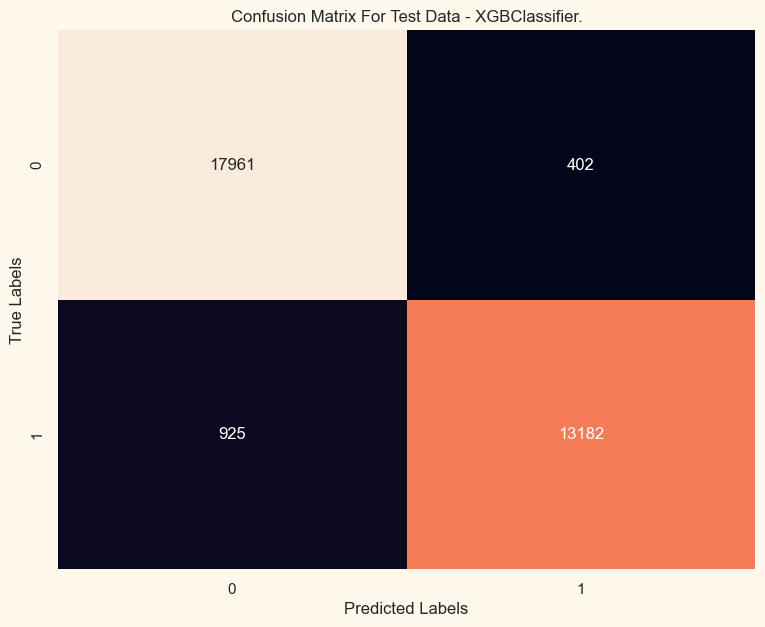

In [157]:
conf_matrix(model=XGB_clf,
           title="Confusion Matrix For Test Data - XGBClassifier.")

#### `With Solve Imbalancing Using SMOTE.`

In [158]:
# Create an XGBoost classifier
XGB_clf_smote = XGBClassifier(
    objective='binary:logistic', ## Specify the objective function for binary classification
    n_estimators=150, ## Number of boosting rounds (trees) to build in the ensemble
    max_depth=5, ## Maximum depth of each tree in the ensemble
    colsample_bytree=0.8, ## Fraction of features to be randomly selected for building each tree
    subsample=0.9, ## Fraction of the training data to be used for building each tree
    reg_lambda=100, ## L2 regularization term to control overfitting
    learning_rate=0.2 ## Learning rate for controlling the step size during optimization
)

XGB_clf_smote.fit(X_train_resampled, y_train_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=150, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

`Model Performance` 

In [159]:
model_performance(model_name="XGBClassifier With Solve Imbalancing Using SMOTE.",
                  model=XGB_clf_smote,
                  X_train_data=X_train_resampled,
                  X_test_data=X_test_final,
                  y_train_data=y_train_resampled,
                  y_test_data=y_test)

==> Model and some Details: XGBClassifier With Solve Imbalancing Using SMOTE.
************************************************************
F1-score for training data using XGBClassifier With Solve Imbalancing Using SMOTE. : 96.39999999999999 %
F1-score for testing data using XGBClassifier With Solve Imbalancing Using SMOTE. : 95.3 %
************************************************************
Accuracy Score for training data using XGBClassifier With Solve Imbalancing Using SMOTE. : 96.5 %
Accuracy Score for testing data using XGBClassifier With Solve Imbalancing Using SMOTE. : 95.89999999999999 %


### 6.7.1 Let's Tuning XGBClassifier Using Random Search.

In [161]:
## Define the parameter grid with the ranges for hyperparameters
param_grid = {
    'n_estimators': np.arange(100, 1000, 100),  ## Range of the number of trees
    'max_depth': np.arange(3, 10, 1),  ## Range of maximum depth
    'colsample_bytree': np.arange(0.5, 1.0, 0.1),  ## Range of feature sampling fraction
    'subsample': np.arange(0.5, 1.0, 0.1),  ## Range of subsampling fraction
    'reg_lambda': [0, 1, 10, 100],  ## List of regularization strengths
    'learning_rate': [0.01, 0.1, 0.2, 0.3]  ## List of learning rates
}

## Create the XGBoost classifier
xgb_clf = XGBClassifier(objective='binary:logistic')

## Create the RandomizedSearchCV object
xgb_random = RandomizedSearchCV(
    xgb_clf,  # Estimator
    param_distributions=param_grid,  # Parameter grid
    n_iter=100,  # Number of random combinations to try
    scoring=f1_scorer,  # Scoring metric
    cv=5,  # Number of cross-validation folds
    n_jobs=-1,  # Use all available CPU cores
    verbose=4, 
    random_state=42  # Set a random seed for reproducibility
)

## Fit the RandomizedSearchCV 
xgb_random.fit(X_train_final, y_train)  

## Print the best hyperparameters and corresponding accuracy
print(f"Best Hyperparameters: {xgb_random.best_params_}")
print(f"Best Accuracy: {xgb_random.best_score_}")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best Hyperparameters: {'subsample': 0.8999999999999999, 'reg_lambda': 100, 'n_estimators': 600, 'max_depth': 9, 'learning_rate': 0.1, 'colsample_bytree': 0.8999999999999999}
Best Accuracy: 0.9623857920131403


### 6.7.2 Retrain XBGOOST After Tuning..

In [162]:
XGB_tuned = xgb_random.best_estimator_
XGB_tuned.fit(X_train_final, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8999999999999999, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=9, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=600, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [163]:
model_performance(model_name="XGBClassifier After Tuning.",
                  model=XGB_tuned,
                  X_train_data=X_train_final,
                  X_test_data=X_test_final,
                  y_train_data=y_train,
                  y_test_data=y_test)

==> Model and some Details: XGBClassifier After Tuning.
************************************************************
F1-score for training data using XGBClassifier After Tuning. : 97.6 %
F1-score for testing data using XGBClassifier After Tuning. : 95.6 %
************************************************************
Accuracy Score for training data using XGBClassifier After Tuning. : 97.89999999999999 %
Accuracy Score for testing data using XGBClassifier After Tuning. : 96.3 %


In [164]:
cross_validation(model_name="Cross Validation Using XGBClassifier && Scoring=f1-score && After Tuning.",
                 model=XGB_tuned,
                 X_valid=X_train_final,
                 y_valid=y_train)

==> Model Name and Details > Cross Validation Using XGBClassifier && Scoring=f1-score && After Tuning.
************************************************************
Train score : 0.98 
standard deviation For Train Score : 0.0
************************************************************
Test score : 0.96 
standard deviation For Test Score : 0.001


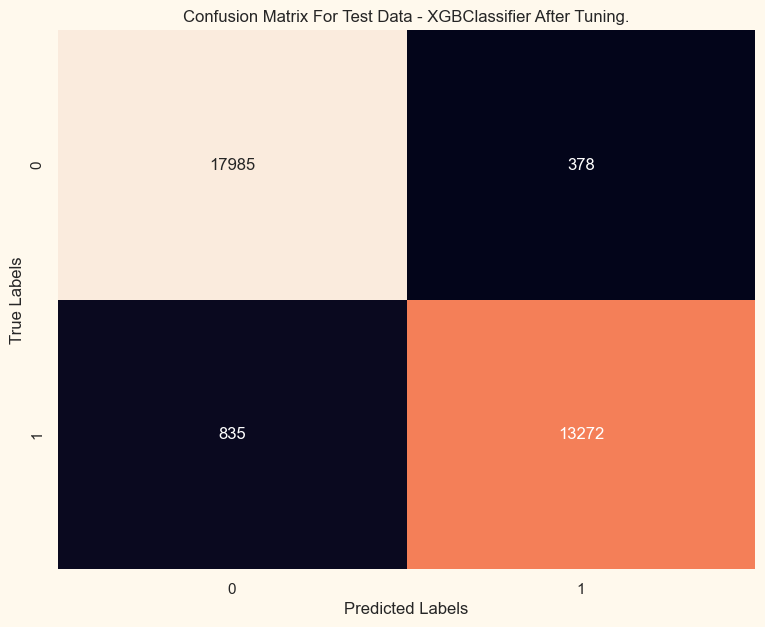

In [165]:
conf_matrix(model=XGB_tuned,
           title="Confusion Matrix For Test Data - XGBClassifier After Tuning.")

In [166]:
y_test_predicted = XGB_tuned.predict(X_test_final)
print("Recall score for XGBOOST After Tuning :\n",recall_score(y_true=y_test, y_pred=y_test_predicted))
print("**"*30)
print("Precision Score for XGBOOST After Tuning :\n",precision_score(y_true=y_test, y_pred=y_test_predicted))
print("**"*30)
print("Classification report for XGBOOST After Tuning :\n",classification_report(y_true=y_test, y_pred=y_test_predicted))

Recall score for XGBOOST After Tuning :
 0.9408095271850854
************************************************************
Precision Score for XGBOOST After Tuning :
 0.9723076923076923
************************************************************
Classification report for XGBOOST After Tuning :
               precision    recall  f1-score   support

           0       0.96      0.98      0.97     18363
           1       0.97      0.94      0.96     14107

    accuracy                           0.96     32470
   macro avg       0.96      0.96      0.96     32470
weighted avg       0.96      0.96      0.96     32470



In [167]:
_ = joblib.dump(XGB_tuned, "XGBOOST.pkl")

<div style=" background-color:#FFF9ED;
            text-align:center;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h3>I will use XGBoost in deployment because it achieved the highest performance of 95.6% (f1-score).
</h3>
</div>

<div style=" background-color:#FFF9ED;
            text-align:center;
            padding: 13px 13px; 
            border-radius: 8px; 
            margin: auto;
            color: black">
<h1>Done ✌😎.
</h1>
</div>